In [1]:
import os
import shutil

import copy
import time

In [2]:
from evo.tools import log
log.configure_logging(verbose=True, debug=True, silent=False)

import pprint
import numpy as np

from evo.tools import plot
import matplotlib.pyplot as plt
%matplotlib inline
%matplotlib notebook

# temporarily override some package settings
from evo.tools.settings import SETTINGS
SETTINGS.plot_usetex = False

import pandas as pd
import time

[DEBUG][2023-07-31 23:04:38,372][log.configure_logging():112]
System info:
Python 3.8.17
Linux-5.19.0-50-generic-x86_64-with-glibc2.17
slam@slam-TensorBook



In [3]:
from evo.tools import file_interface
from evo.core import sync
from evo.core import metrics

In [4]:
import matplotlib.pyplot as plt

In [5]:
scriptTemplate = "./Examples/Monocular/{} ./Vocabulary/ORBvoc.txt ./Examples/Monocular/{} ./datasets/{} ./Examples/Monocular/{}"

In [6]:
## Configurations

benchmark2program = {"SenseTime": "mono_tum_vi"}
benchmark2trajectory = {"SenseTime": ["A0", "A1", "A2", "A3", "A4", "A5", "A6", "A7"]}
benchmark2config = {"SenseTime": "SenseTime.yaml"}
benchmark2folder = {"SenseTime": "/camera/images/"}
benchmark2gtruth = {"SenseTime": "/groundtruth/data.csv"}

In [7]:
def copy_file_and_rename(source_file_path, destination_folder_path, new_filename):
    try:
        # Check if the source file exists
        if not os.path.exists(source_file_path):
            raise FileNotFoundError(f"The source file '{source_file_path}' does not exist.")

        # Create the destination folder if it doesn't exist
        if not os.path.exists(destination_folder_path):
            os.makedirs(destination_folder_path)

        # Create the destination file path by joining the destination folder and new filename
        destination_file_path = os.path.join(destination_folder_path, new_filename)

        # Copy the file from the source path to the destination path
        shutil.copy2(source_file_path, destination_file_path)

        print(f"File copied successfully and renamed to '{new_filename}' in '{destination_folder_path}'.")
    except Exception as e:
        print(f"Error: {e}")

In [8]:
def getSLAMScript(benchmarks):
    scriptList = []
    scriptTemp = copy.deepcopy(scriptTemplate)
    for benchmark in benchmarks:
        for trajectory in benchmark2trajectory[benchmark]:
            scriptDict = {"benchmark": benchmark, "trajectory": trajectory, "script": None, "gt": None}
            program = benchmark2program[benchmark]
            config = benchmark2config[benchmark]
            dataset = benchmark + "/" + trajectory + benchmark2folder[benchmark]
            timeStamp = benchmark + "_TimeStamps/" + trajectory + ".txt"
            scriptDict["script"] = scriptTemp.format(program, config, dataset, timeStamp)
            scriptDict["gt"] = "./datasets/{}/{}".format(benchmark, trajectory) + benchmark2gtruth[benchmark]
            scriptList.append(scriptDict)
    return scriptList

In [9]:
def read_log():
    # Step 1: Read the CSV file
    df = pd.read_csv("./logs/log.csv")

    # Step 2: Drop the header line (if needed)
    # If the header line needs to be dropped, you can reset the index after skipping the first row.
    # Uncomment the next line if you want to remove the header line.
    target = 2
    # Find the row index of the first occurrence of the target in the column
    initial_rows = (df["TrackMode"] == target).idxmax()
    initial_rows += 1
    
    df = df.iloc[initial_rows:].reset_index(drop=True)
    
    df_traj = copy.deepcopy(df)
    # Step 3: Select several columns by their names
    selected_columns = ["TimeStamp","PX","PY","PZ","QX","QY","QZ","QW"]  # Replace with your desired column names
    df_traj = df_traj[selected_columns]
    
    # Set rows to NaN where the conditions are met
    #df_traj.loc[(df['PX']==0) & (df['PY'] == 0) & (df['PZ'] == 0), ["PX", "PY", "PZ", "Q4", "Q1", "Q2", "Q3"]] = pd.NA
    
    # Step 4: Save the DataFrame as a text (TXT) file
    df_traj.to_csv("./logs/trajectory.txt", sep=' ', index=False, header=False)  # You can change the separator as needed
    
    return df, df_traj, initial_rows

In [10]:
def copy_gtruth(scriptDict):
    source_file_path = scriptDict["gt"]
    #copy_file_and_rename(source_file_path, target_folder_path, file_name)

    df = pd.read_csv(source_file_path)
    columns = ["#t[s:double]","p.x[m:double]", "p.y[m:double]", "p.z[m:double]", \
               "q.x[double]", "q.y[double]", "q.z[double]", "q.w[double]"]
    df = df[columns]
    df.to_csv("./logs/ground_truth.txt", sep=' ', index=False, header=False)

In [11]:
# source_file_path = scriptDict["gt"]
#     #copy_file_and_rename(source_file_path, target_folder_path, file_name)

# df = pd.read_csv(source_file_path)
# df.to_csv("./logs/ground_truth.txt", sep=' ', index=False, header=False)

In [12]:
#df

In [13]:
def delete_files_in_folder(folder_path):
    try:
        # List all files in the folder
        files = os.listdir(folder_path)

        # Loop through the files and delete them one by one
        for file in files:
            file_path = os.path.join(folder_path, file)
            if os.path.isfile(file_path):
                os.remove(file_path)
                print(f"Deleted: {file_path}")
            else:
                print(f"Skipping: {file_path} (It is not a file)")

        print("All files deleted successfully.")
    except Exception as e:
        print(f"An error occurred: {e}")

In [14]:
est_file = "./logs/trajectory.txt"
traj_est = file_interface.read_tum_trajectory_file(est_file)

[DEBUG][2023-07-31 23:04:40,593][file_interface.read_tum_trajectory_file():117]
Loaded 1957 stamps and poses from: ./logs/trajectory.txt


## Relative Error Calculation

In [15]:
def calculate_RE(delta=60):
    ref_file = "./logs/ground_truth.txt"
    est_file = "./logs/trajectory.txt"

    traj_est = file_interface.read_tum_trajectory_file(est_file)
    traj_ref = file_interface.read_tum_trajectory_file(ref_file)
    
    max_diff = 0.01
    traj_ref, traj_est = sync.associate_trajectories(traj_ref, traj_est, max_diff)

    traj_est_aligned = copy.deepcopy(traj_est)
    traj_est_aligned.align(traj_ref, correct_scale=True, correct_only_scale=False)

    pose_relation = metrics.PoseRelation.translation_part

    delta_unit = metrics.Unit.frames

    # all pairs mode
    all_pairs = True #False # True  # activate
    
    data = (traj_ref, traj_est)
    data = (traj_ref, traj_est_aligned)
    
    rpe_metric = metrics.RPE(pose_relation=pose_relation, delta=delta,
                             delta_unit=delta_unit, all_pairs=all_pairs)
    rpe_metric.process_data(data)
    
    error = np.array(rpe_metric.error)/float(delta)
    
    return traj_est, traj_ref, error

In [16]:
def plot_aligned_trajectory(traj_est, traj_ref, benchmark, trajectory, trial):
    fig = plt.figure(figsize=[10,10])
    
    traj_est_aligned = copy.deepcopy(traj_est)
    traj_est_aligned.align(traj_ref, correct_scale=True, correct_only_scale=False)
    
    traj_by_label = {
        #"estimate (not aligned)": traj_est,
        "estimate (aligned)": traj_est_aligned,
        "reference": traj_ref
    }
    
    plot.trajectories(fig, traj_by_label, plot.PlotMode.xyz)
    fig.savefig('./figures/{}-{}-{}-trajectory.png'.format(benchmark, trajectory, trial))

In [17]:
def plot_error(error, delta, benchmark, trajectory, trial):

    fig = plt.figure(figsize=[10,3])
    # Plot the line
    plt.plot(error)
    plt.ylim(-0.01,0.05)
    # Add labels and title
    plt.xlabel('Time Step')
    plt.ylabel('Relative Error')
    plt.title('Relative Error on {}-{}-{} with sub-trajectory={} frames'.format(benchmark, 
                                                                                  trajectory, 
                                                                                  trial, 
                                                                                  delta))

    fig.savefig('./figures/{}-{}-{}-error.png'.format(benchmark, trajectory, trial))
    # Display the plot
    #plt.show()

In [18]:
def attach_label_2_features(delta, error, df):
    new_column_name = 'RelativeError'
    df_label = pd.DataFrame({new_column_name: error})
    df = df.iloc[delta:].reset_index(drop=True)
    assert(len(df) == len(df_label))
    data_df = pd.concat([df_label, df], axis=1)
    return data_df

## Run

In [19]:
SLAMScripts = getSLAMScript(["SenseTime"])
SLAMScripts

[{'benchmark': 'SenseTime',
  'trajectory': 'A0',
  'script': './Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A0/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A0.txt',
  'gt': './datasets/SenseTime/A0/groundtruth/data.csv'},
 {'benchmark': 'SenseTime',
  'trajectory': 'A1',
  'script': './Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A1/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A1.txt',
  'gt': './datasets/SenseTime/A1/groundtruth/data.csv'},
 {'benchmark': 'SenseTime',
  'trajectory': 'A2',
  'script': './Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A2/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A2.txt',
  'gt': './datasets/SenseTime/A2/groundtruth/data.csv'},
 {'benchmark': 'SenseTime',
  'trajectory': 'A3',
  'script': './Examples/Monocular/mono_tu

In [20]:
#SLAMScripts = SLAMScripts
#SLAMScripts

Deleted: ./logs/ground_truth.txt
Deleted: ./logs/log.csv
Deleted: ./logs/trajectory.txt
All files deleted successfully.
Deleted: ./data/SenseTime_A0.csv
Deleted: ./data/SenseTime_A4.csv
Deleted: ./data/SenseTime_A5.csv
Deleted: ./data/SenseTime_A2.csv
Deleted: ./data/SenseTime_A6.csv
Deleted: ./data/SenseTime_A7.csv
Deleted: ./data/SenseTime_A3.csv
Deleted: ./data/SenseTime_A1.csv
All files deleted successfully.
Deleted: ./figures/SenseTime-A7-error.png
Deleted: ./figures/SenseTime-A4-trajectory.png
Deleted: ./figures/SenseTime-A7-trajectory.png
Deleted: ./figures/SenseTime-A2-trajectory.png
Deleted: ./figures/SenseTime-A0-error.png
Deleted: ./figures/SenseTime-A5-trajectory.png
Deleted: ./figures/SenseTime-A6-trajectory.png
Deleted: ./figures/SenseTime-A1-trajectory.png
Deleted: ./figures/SenseTime-A1-error.png
Deleted: ./figures/SenseTime-A5-error.png
Deleted: ./figures/SenseTime-A0-trajectory.png
Deleted: ./figures/SenseTime-A3-trajectory.png
Deleted: ./figures/SenseTime-A4-error.pn

<IPython.core.display.Javascript object>


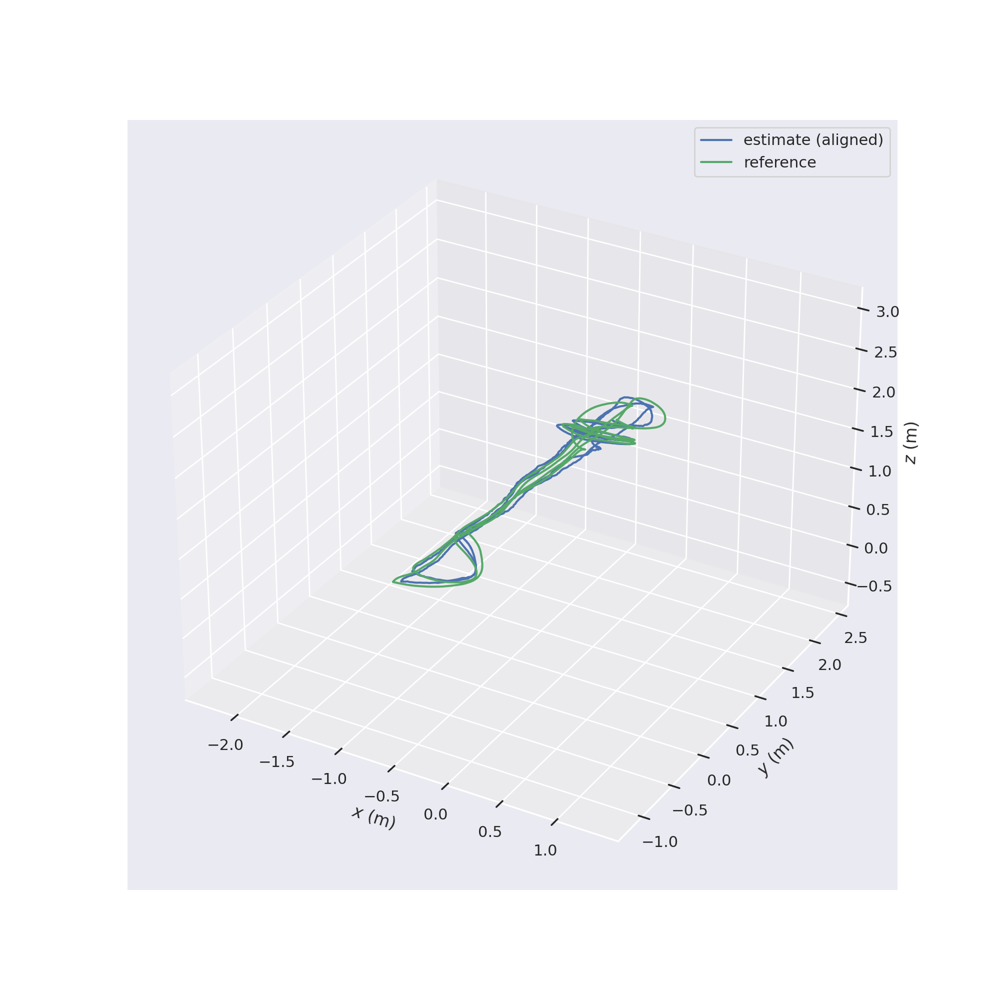

[DEBUG][2023-07-31 23:06:17,656][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:06:17,660][trajectory.align():214]
Rotation of alignment:
[[-0.17155454  0.98276704  0.068833  ]
 [ 0.84309486  0.18260022 -0.50581441]
 [-0.50966665 -0.02874201 -0.85989174]]
Translation of alignment:
[-0.47079616  2.11722063  1.22109871]
[DEBUG][2023-07-31 23:06:17,660][trajectory.align():216]
Scale correction: 1.456424031596419


<IPython.core.display.Javascript object>


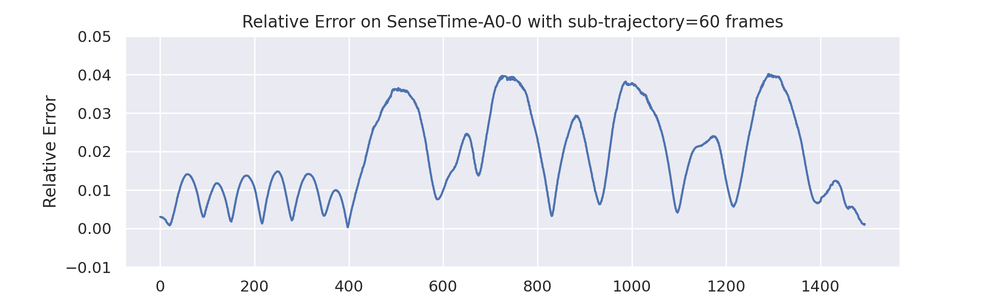

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A0/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A0.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>


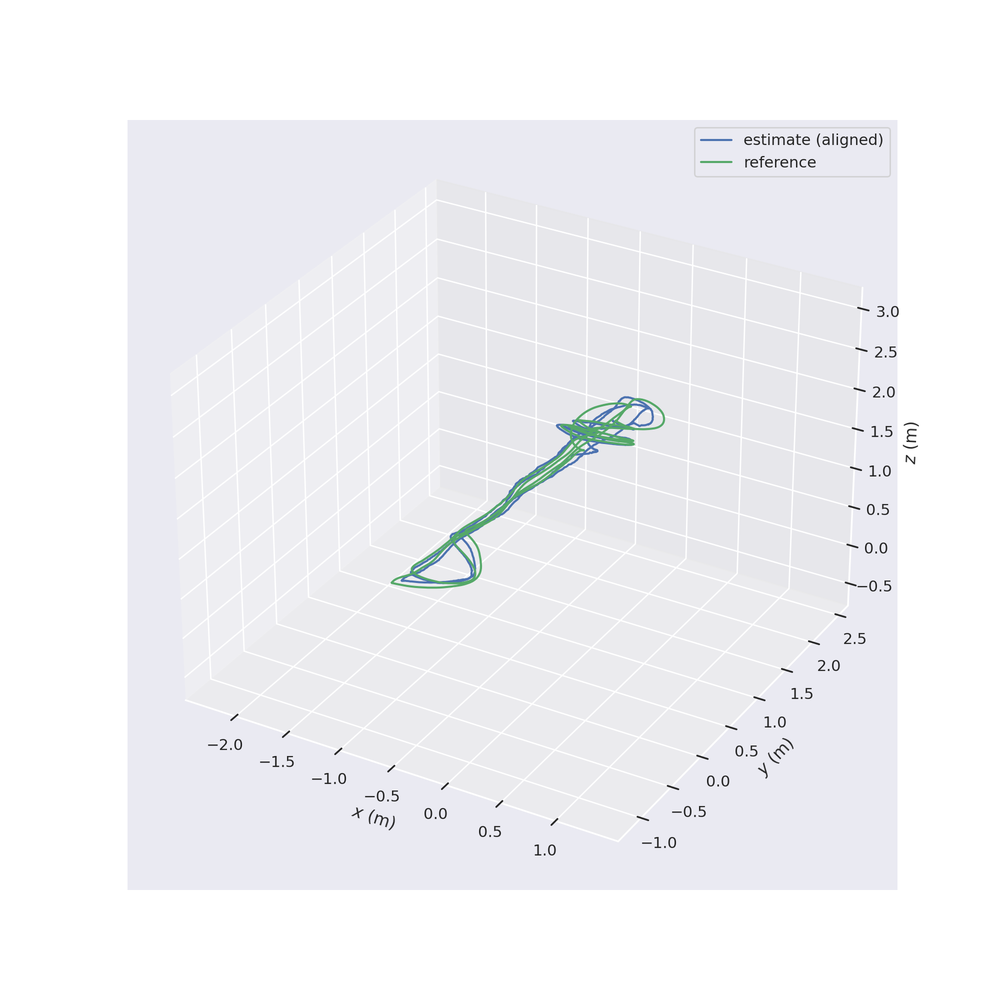

[DEBUG][2023-07-31 23:07:48,254][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:07:48,258][trajectory.align():214]
Rotation of alignment:
[[-0.17619241  0.98296049  0.05239182]
 [ 0.84585352  0.17841007 -0.50269442]
 [-0.50347598 -0.04425513 -0.86287509]]
Translation of alignment:
[-0.45266793  2.11026349  1.23498573]
[DEBUG][2023-07-31 23:07:48,259][trajectory.align():216]
Scale correction: 1.474952271519443


<IPython.core.display.Javascript object>


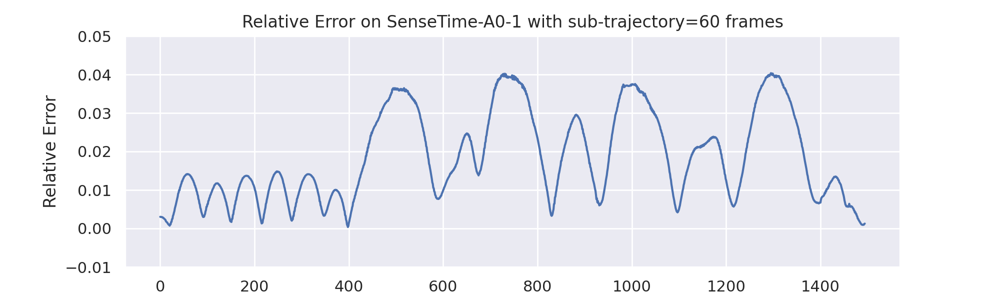

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A0/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A0.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>


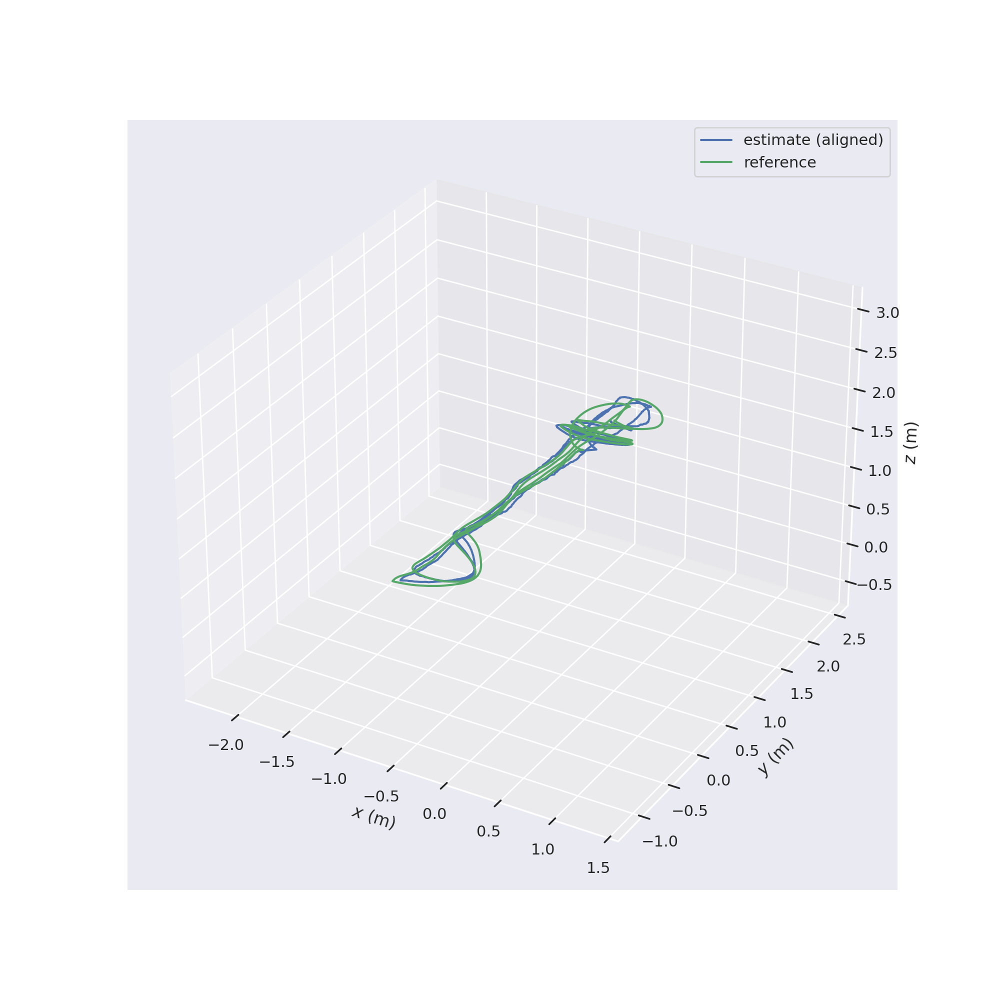

[DEBUG][2023-07-31 23:09:18,815][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:09:18,819][trajectory.align():214]
Rotation of alignment:
[[-0.18072973  0.98239572  0.04728025]
 [ 0.8452283   0.17971688 -0.50328021]
 [-0.50291738 -0.05099509 -0.86282884]]
Translation of alignment:
[-0.4605188   2.10851814  1.22218373]
[DEBUG][2023-07-31 23:09:18,819][trajectory.align():216]
Scale correction: 1.4550308400909229


<IPython.core.display.Javascript object>


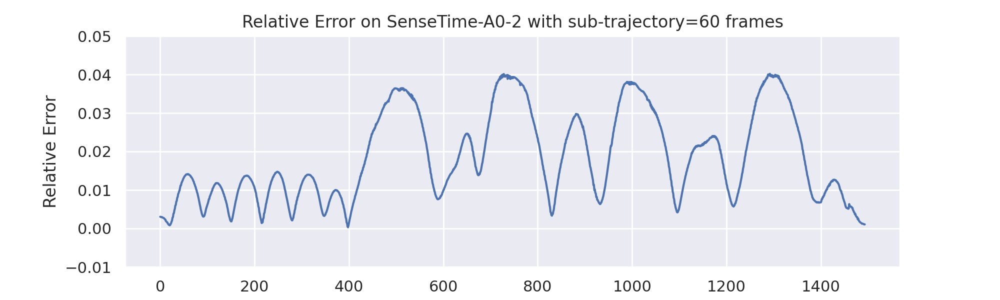

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A0/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A0.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>


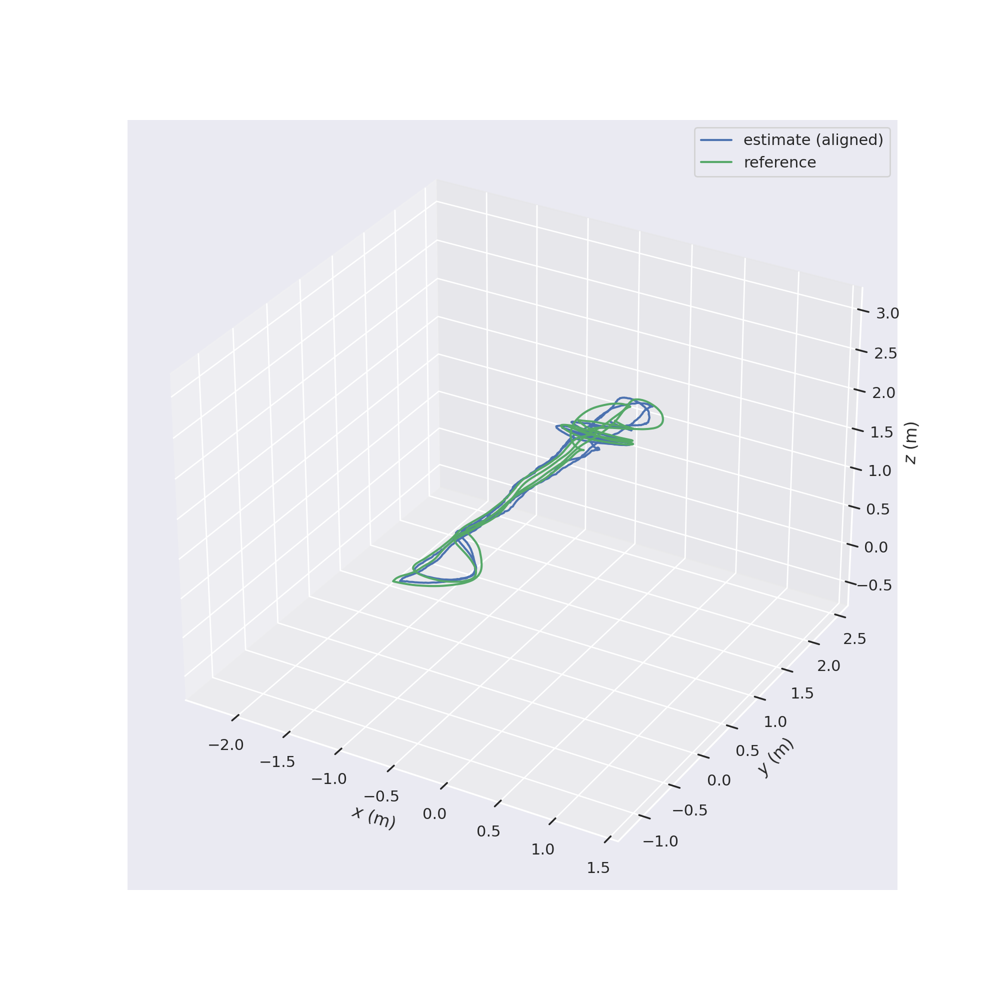

[DEBUG][2023-07-31 23:10:49,373][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:10:49,377][trajectory.align():214]
Rotation of alignment:
[[-0.17771046  0.98232228  0.05883813]
 [ 0.84357029  0.1828528  -0.50492972]
 [-0.50676243 -0.0400972  -0.86115275]]
Translation of alignment:
[-0.46652026  2.10667518  1.22096339]
[DEBUG][2023-07-31 23:10:49,378][trajectory.align():216]
Scale correction: 1.4738046377626783


<IPython.core.display.Javascript object>


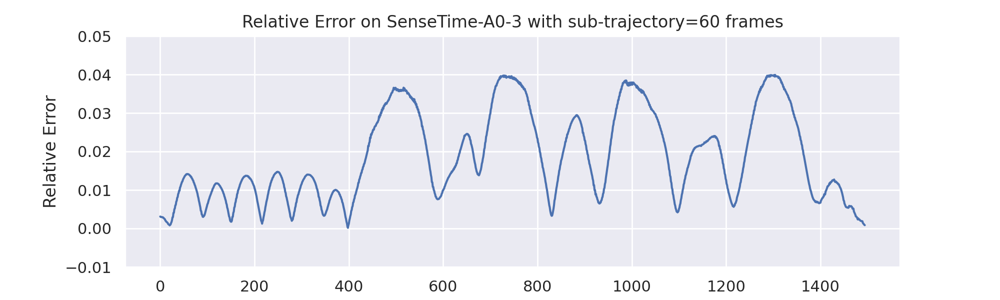

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A0/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A0.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

virtual int g2o::SparseOptimizer::optimize(int, bool): 0 vertices to optimize, maybe forgot to call initializeOptimization()
virtual int g2o::SparseOptimizer::optimize(int, bool): 0 vertices to optimize, maybe forgot to call initializeOptimization()
virtual int g2o::SparseOptimizer::optimize(int, bool): 0 vertices to optimize, maybe forgot to call initializeOptimization()


Relocalized!!
Shutdown

Saving trajectory to CameraTrajectory.txt ...
There are 1 maps in the atlas
  Map 0 has 283 KFs

End of saving trajectory to CameraTrajectory.txt ...

Saving keyframe trajectory to KeyFrameTrajectory.txt ...
-------

median tracking time: 0.010934034362435341
mean tracking time: 0.012567122466862202


The program 'mono_tum_vi' received an X Window System error.
This probably reflects a bug in the program.
The error was 'BadWindow (invalid Window parameter)'.
  (Details: serial 24496 error_code 3 request_code 20 minor_code 0)
  (Note to programmers: normally, X errors are reported asynchronously;
   that is, you will receive the error a while after causing it.
   To debug your program, run it with the --sync command line
   option to change this behavior. You can then get a meaningful
   backtrace from your debugger if you break on the gdk_x_error() function.)
Segmentation fault (core dumped)


[DEBUG][2023-07-31 23:12:19,808][file_interface.read_tum_trajectory_file():117]
Loaded 1555 stamps and poses from: ./logs/trajectory.txt
[DEBUG][2023-07-31 23:12:19,917][file_interface.read_tum_trajectory_file():117]
Loaded 24578 stamps and poses from: ./logs/ground_truth.txt
[DEBUG][2023-07-31 23:12:19,943][sync.associate_trajectories():110]
Found 1555 of max. 1555 possible matching timestamps between...
	first trajectory
and:	second trajectory
..with max. time diff.: 0.01 (s) and time offset: 0.0 (s).
[DEBUG][2023-07-31 23:12:19,944][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:12:19,949][trajectory.align():214]
Rotation of alignment:
[[-0.17304215  0.9829424   0.06229485]
 [ 0.84471808  0.18063766 -0.50380691]
 [-0.50646597 -0.03455825 -0.86156715]]
Translation of alignment:
[-0.46437398  2.10212038  1.22809797]
[DEBUG][2023-07-31 23:12:19,949][trajectory.align():216]
Scale correction: 1.414061279470953
[DEBUG][2023-07-31 2

<IPython.core.display.Javascript object>


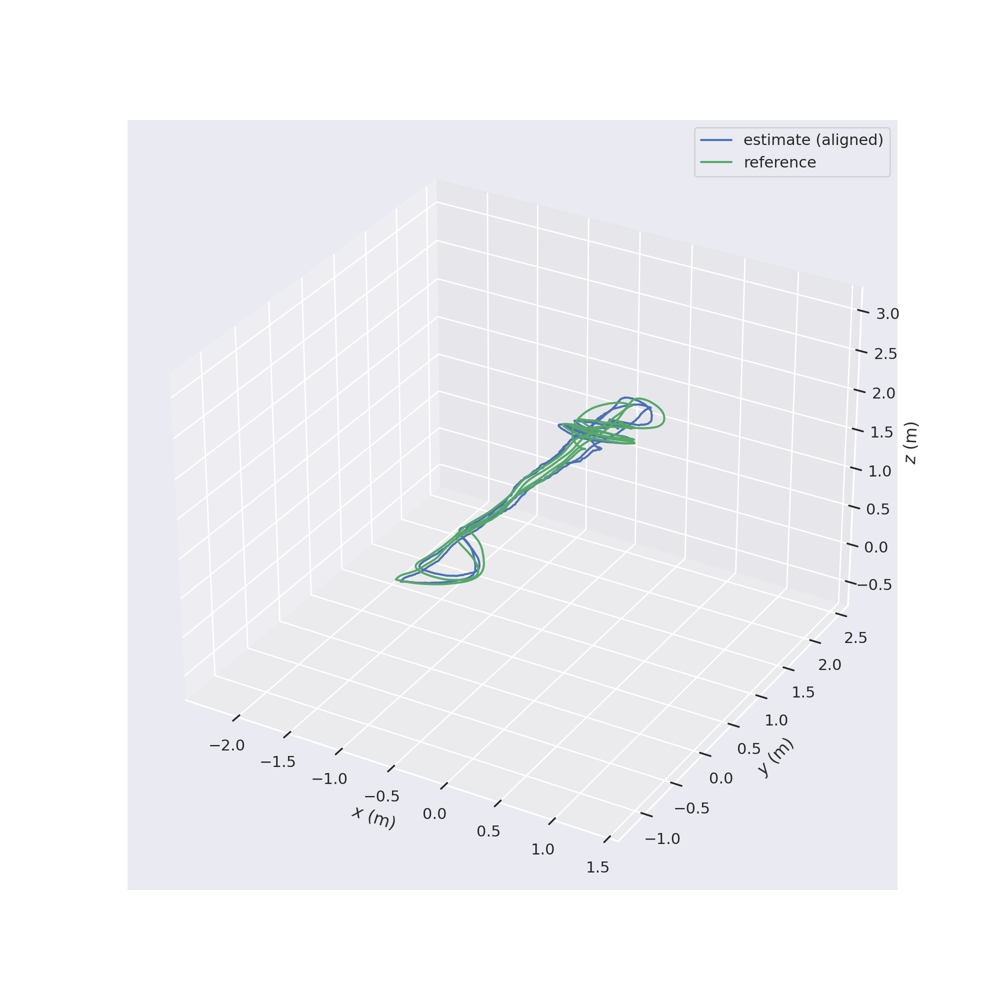

[DEBUG][2023-07-31 23:12:20,009][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:12:20,014][trajectory.align():214]
Rotation of alignment:
[[-0.17304215  0.9829424   0.06229485]
 [ 0.84471808  0.18063766 -0.50380691]
 [-0.50646597 -0.03455825 -0.86156715]]
Translation of alignment:
[-0.46437398  2.10212038  1.22809797]
[DEBUG][2023-07-31 23:12:20,014][trajectory.align():216]
Scale correction: 1.414061279470953


<IPython.core.display.Javascript object>


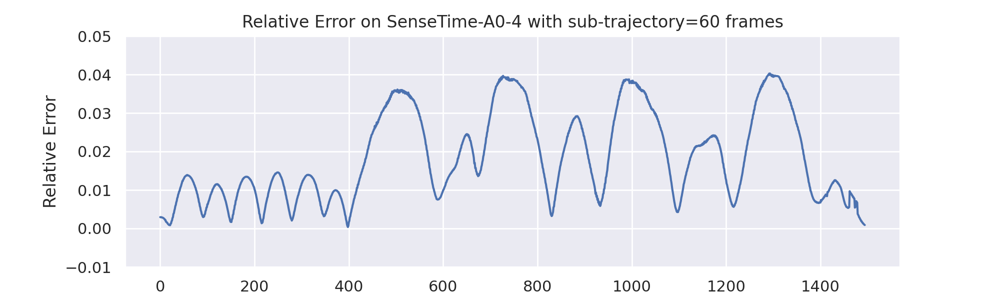

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A1/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A1.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Creation of new map with id: 2
Stored map with ID: 1
Creation of new map with last KF id: 639
First KF:639; Map init KF:639
New Map created with 181 points
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local

First KF:847; Map init KF:847
New Map created with 174 points
*Merge detected
Local Mapping STOP
Change to map with id: 3
Local Mapping RELEASE
Local Mapping RELEASE
Merge finished!
*Merge detected
Local Mapping STOP
Change to map with id: 4
Local Mapping RELEASE
Local Mapping STOP
Local Mapping RELEASE
Merge finished!
Shutdown

Saving trajectory to CameraTrajectory.txt ...
There are 3 maps in the atlas
  Map 0 has 103 KFs
  Map 1 has 94 KFs
  Map 5 has 278 KFs

End of saving trajectory to CameraTrajectory.txt ...

Saving keyframe trajectory to KeyFrameTrajectory.txt ...
-------

median tracking time: 0.0093079619109630585
mean tracking time: 0.010091192089021206
[DEBUG][2023-07-31 23:14:56,618][file_interface.read_tum_trajectory_file():117]
Loaded 3469 stamps and poses from: ./logs/trajectory.txt
[DEBUG][2023-07-31 23:14:56,756][file_interface.read_tum_trajectory_file():117]
Loaded 48189 stamps and poses from: ./logs/ground_truth.txt
[DEBUG][2023-07-31 23:14:56,868][sync.associate_tra

<IPython.core.display.Javascript object>


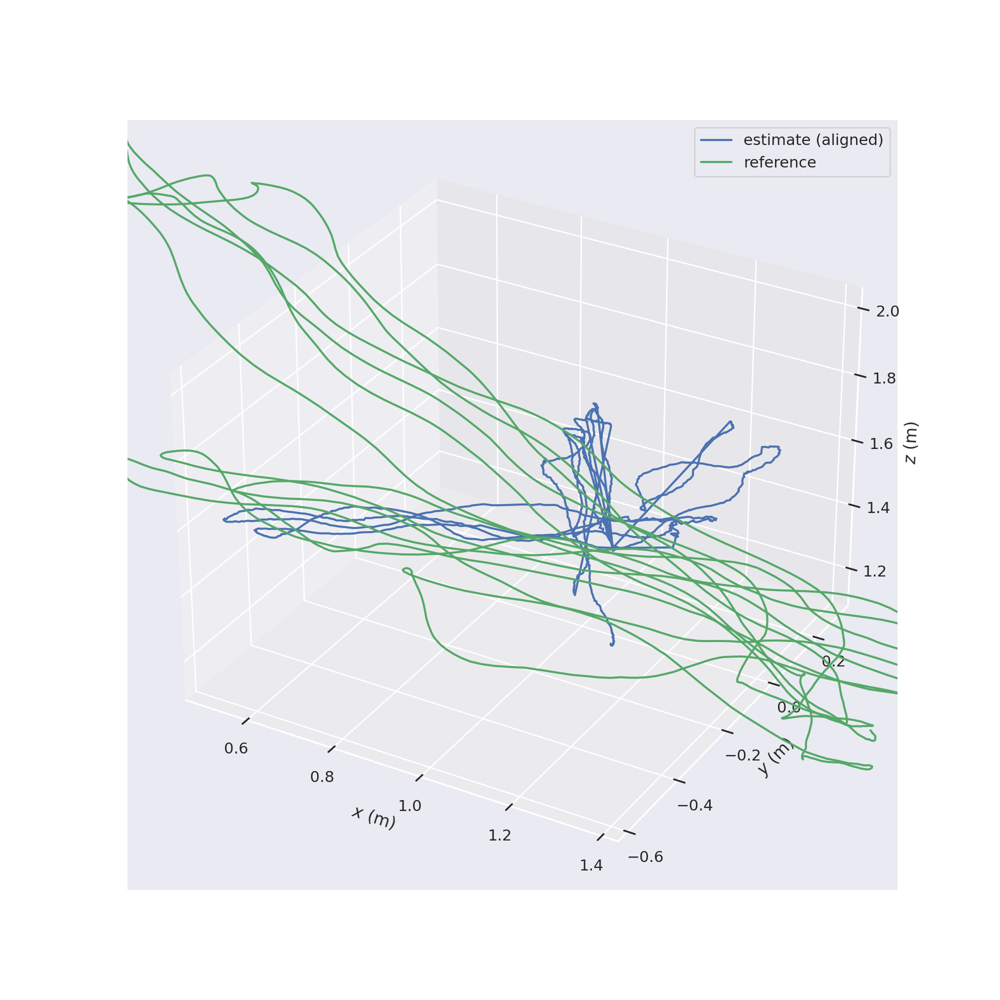

[DEBUG][2023-07-31 23:14:57,001][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:14:57,009][trajectory.align():214]
Rotation of alignment:
[[ 0.28405855  0.79289743 -0.53909592]
 [-0.43722329  0.60751399  0.66314594]
 [ 0.85331503  0.04733301  0.51924277]]
Translation of alignment:
[ 1.20341041 -0.24617796  1.57838884]
[DEBUG][2023-07-31 23:14:57,010][trajectory.align():216]
Scale correction: 0.6356053510544766


<IPython.core.display.Javascript object>


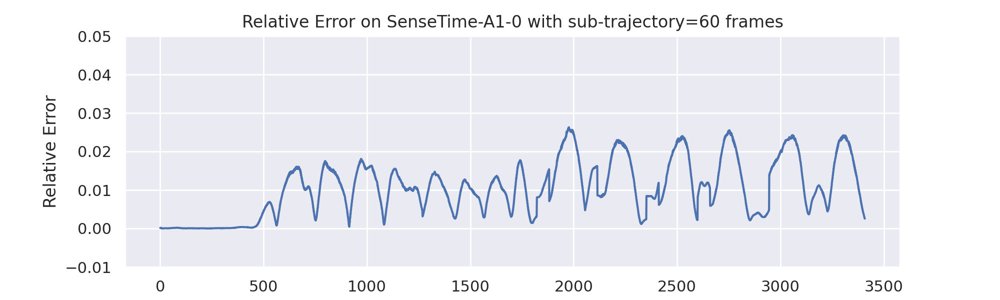

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A1/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A1.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Creation of new map with id: 2
Stored map with ID: 1
Creation of new map with last KF id: 749
First KF:749; Map init KF:749
New Map created with 343 points
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local

Local Mapping STOP
Local Mapping RELEASE
Shutdown

Saving trajectory to CameraTrajectory.txt ...
There are 3 maps in the atlas
  Map 0 has 47 KFs
  Map 1 has 150 KFs
  Map 5 has 240 KFs

End of saving trajectory to CameraTrajectory.txt ...

Saving keyframe trajectory to KeyFrameTrajectory.txt ...
-------

median tracking time: 0.009312857873737812
mean tracking time: 0.0098612299188971519
[DEBUG][2023-07-31 23:17:32,649][file_interface.read_tum_trajectory_file():117]
Loaded 3470 stamps and poses from: ./logs/trajectory.txt
[DEBUG][2023-07-31 23:17:32,784][file_interface.read_tum_trajectory_file():117]
Loaded 48189 stamps and poses from: ./logs/ground_truth.txt
[DEBUG][2023-07-31 23:17:32,893][sync.associate_trajectories():110]
Found 3470 of max. 3470 possible matching timestamps between...
	first trajectory
and:	second trajectory
..with max. time diff.: 0.01 (s) and time offset: 0.0 (s).
[DEBUG][2023-07-31 23:17:32,894][trajectory.align():202]
Aligning using Umeyama's method... (with s

<IPython.core.display.Javascript object>


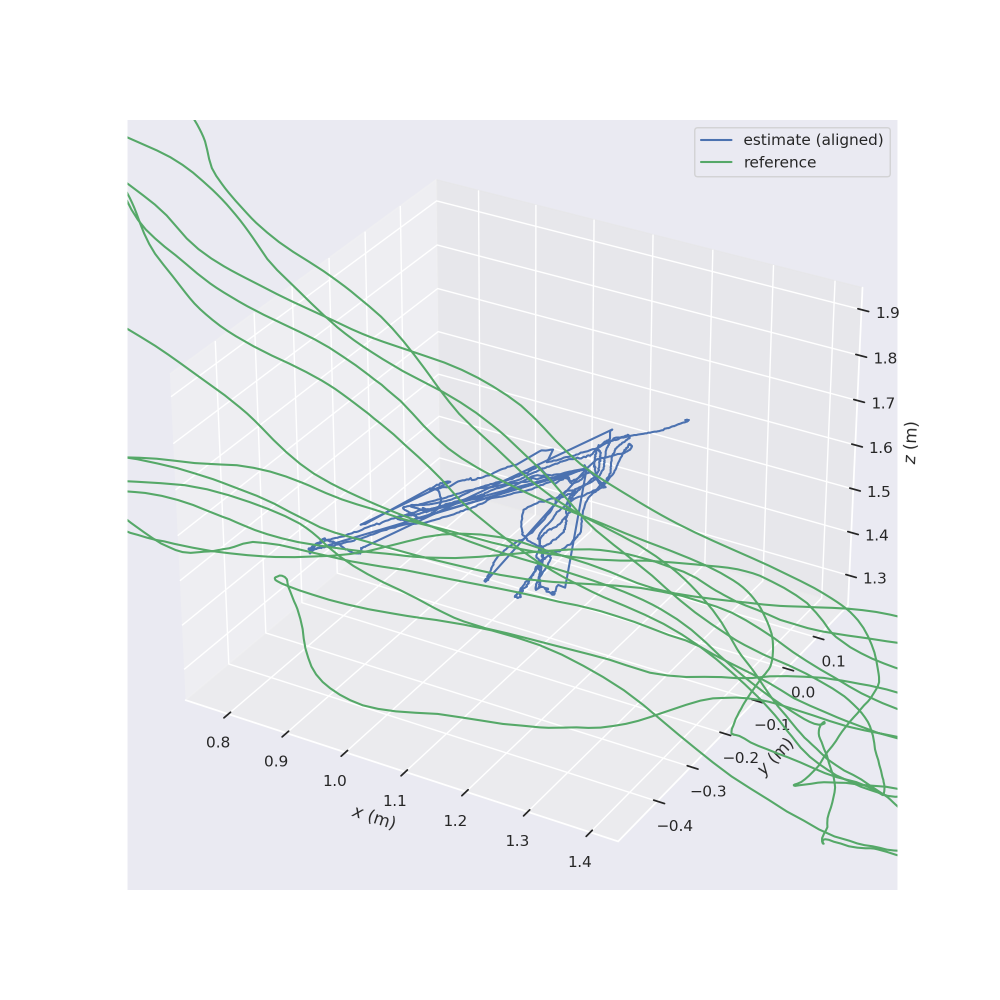

[DEBUG][2023-07-31 23:17:33,027][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:17:33,042][trajectory.align():214]
Rotation of alignment:
[[ 0.15596054  0.85604628 -0.49280937]
 [ 0.43239772 -0.50773965 -0.74513936]
 [-0.88809263 -0.09687731 -0.44933981]]
Translation of alignment:
[ 1.12216582 -0.03134229  1.58008892]
[DEBUG][2023-07-31 23:17:33,043][trajectory.align():216]
Scale correction: 0.5090828851238085


<IPython.core.display.Javascript object>


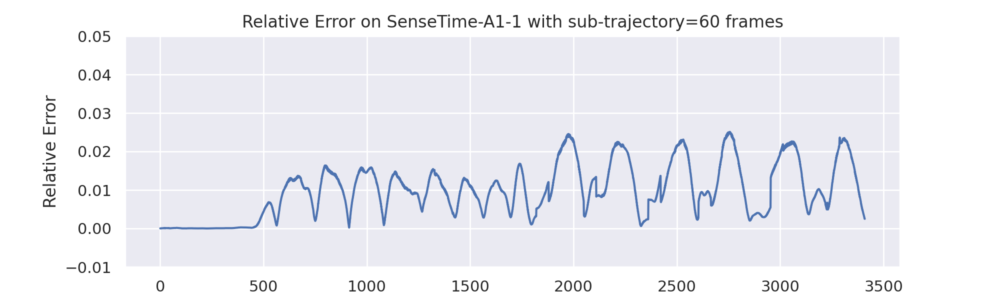

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A1/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A1.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Creation of new map with id: 3
Stored map with ID: 2
Creation of new map with last KF id: 805
First KF:805; Map init KF:805
New Map created with 221 points
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local

*Loop detected
Local Mapping STOP
Local Mapping RELEASE
Local Mapping STOP
Local Mapping RELEASE
Shutdown

Saving trajectory to CameraTrajectory.txt ...
There are 4 maps in the atlas
  Map 0 has 21 KFs
  Map 1 has 101 KFs
  Map 2 has 99 KFs
  Map 6 has 230 KFs

End of saving trajectory to CameraTrajectory.txt ...

Saving keyframe trajectory to KeyFrameTrajectory.txt ...
-------

median tracking time: 0.0093269823119044304
mean tracking time: 0.010089457035064697
[DEBUG][2023-07-31 23:20:08,544][file_interface.read_tum_trajectory_file():117]
Loaded 3471 stamps and poses from: ./logs/trajectory.txt
[DEBUG][2023-07-31 23:20:08,726][file_interface.read_tum_trajectory_file():117]
Loaded 48189 stamps and poses from: ./logs/ground_truth.txt
[DEBUG][2023-07-31 23:20:08,839][sync.associate_trajectories():110]
Found 3471 of max. 3471 possible matching timestamps between...
	first trajectory
and:	second trajectory
..with max. time diff.: 0.01 (s) and time offset: 0.0 (s).
[DEBUG][2023-07-31 23:20

<IPython.core.display.Javascript object>


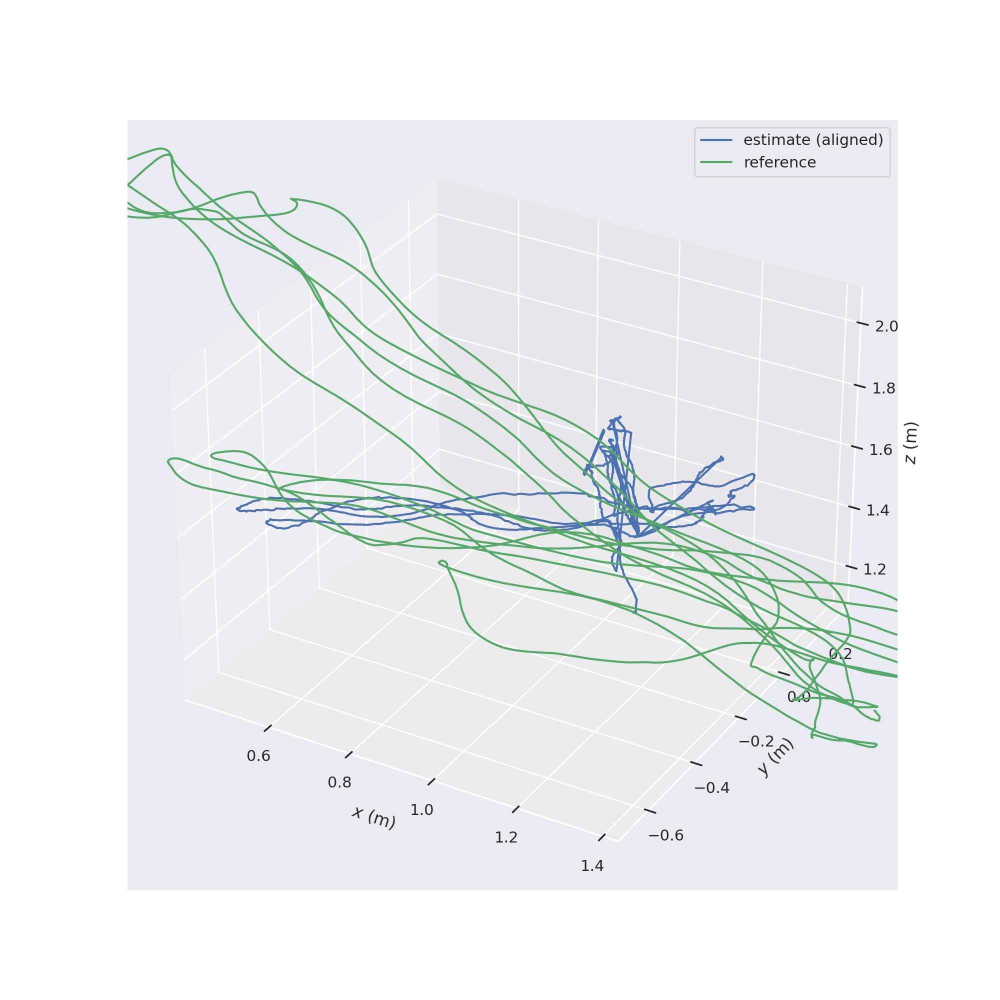

[DEBUG][2023-07-31 23:20:08,978][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:20:08,987][trajectory.align():214]
Rotation of alignment:
[[ 0.28640356  0.7852882  -0.54890385]
 [-0.40801083  0.61832462  0.67171559]
 [ 0.86689109  0.03157698  0.49749646]]
Translation of alignment:
[ 1.20170043 -0.22615132  1.58177888]
[DEBUG][2023-07-31 23:20:08,988][trajectory.align():216]
Scale correction: 0.5500665107760988


<IPython.core.display.Javascript object>


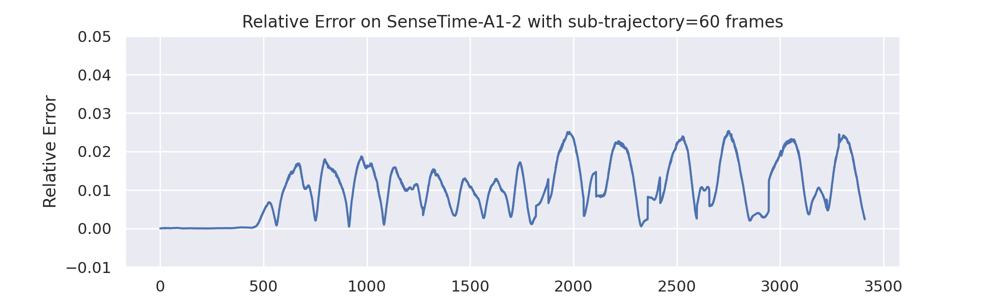

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A1/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A1.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Creation of new map with id: 3
Stored map with ID: 2
Creation of new map with last KF id: 626
First KF:626; Map init KF:626
New Map created with 75 points
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local 

Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!


<IPython.core.display.Javascript object>


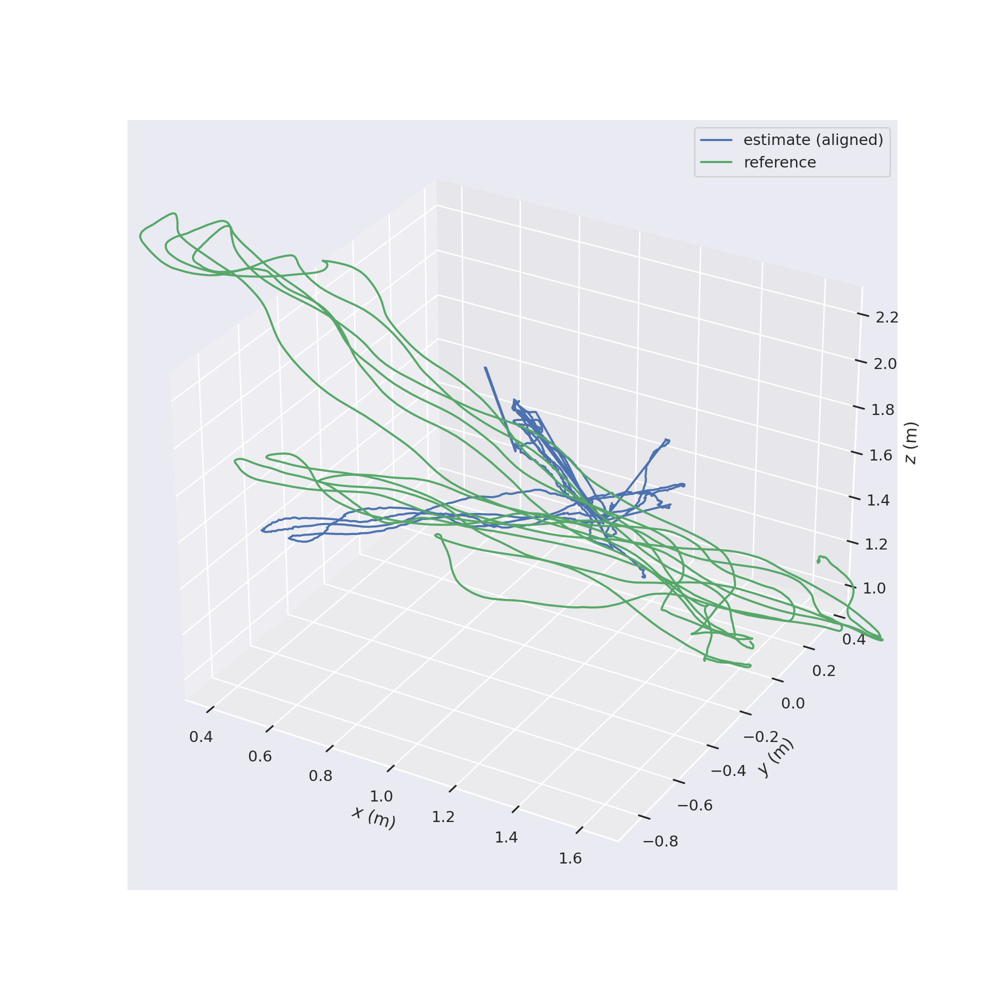

[DEBUG][2023-07-31 23:22:45,002][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:22:45,010][trajectory.align():214]
Rotation of alignment:
[[ 0.40460189  0.59637427 -0.69327847]
 [-0.28254922  0.80253242  0.52545947]
 [ 0.86974896 -0.0167166   0.49321122]]
Translation of alignment:
[ 1.26548279 -0.21831671  1.5818732 ]
[DEBUG][2023-07-31 23:22:45,010][trajectory.align():216]
Scale correction: 0.8778583000365221


<IPython.core.display.Javascript object>


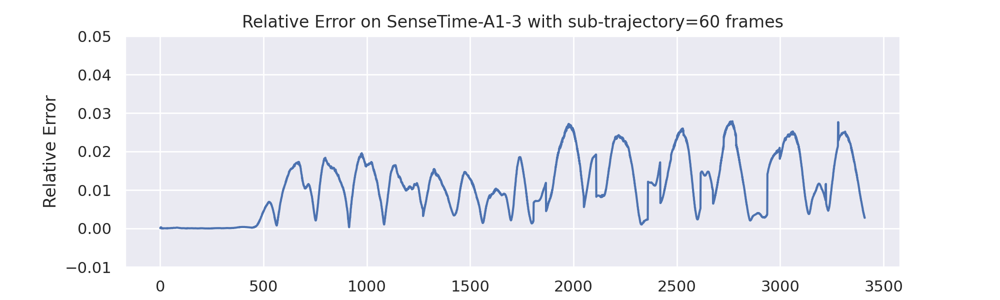

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A1/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A1.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Creation of new map with id: 3
Stored map with ID: 2
Creation of new map with last KF id: 818
First KF:818; Map init KF:818
New Map created with 223 points
TRACK_REF_KF: Less than 15 matches!!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to track local map!
Fail to

*Loop detected
Local Mapping STOP
Local Mapping RELEASE
Local Mapping STOP
Local Mapping RELEASE
Shutdown

Saving trajectory to CameraTrajectory.txt ...
There are 4 maps in the atlas
  Map 0 has 17 KFs
  Map 1 has 114 KFs
  Map 2 has 92 KFs
  Map 6 has 239 KFs

End of saving trajectory to CameraTrajectory.txt ...

Saving keyframe trajectory to KeyFrameTrajectory.txt ...
-------

median tracking time: 0.0093312617391347885
mean tracking time: 0.010056867264211178
[DEBUG][2023-07-31 23:25:20,583][file_interface.read_tum_trajectory_file():117]
Loaded 3470 stamps and poses from: ./logs/trajectory.txt
[DEBUG][2023-07-31 23:25:20,719][file_interface.read_tum_trajectory_file():117]
Loaded 48189 stamps and poses from: ./logs/ground_truth.txt
[DEBUG][2023-07-31 23:25:20,831][sync.associate_trajectories():110]
Found 3470 of max. 3470 possible matching timestamps between...
	first trajectory
and:	second trajectory
..with max. time diff.: 0.01 (s) and time offset: 0.0 (s).
[DEBUG][2023-07-31 23:25

<IPython.core.display.Javascript object>


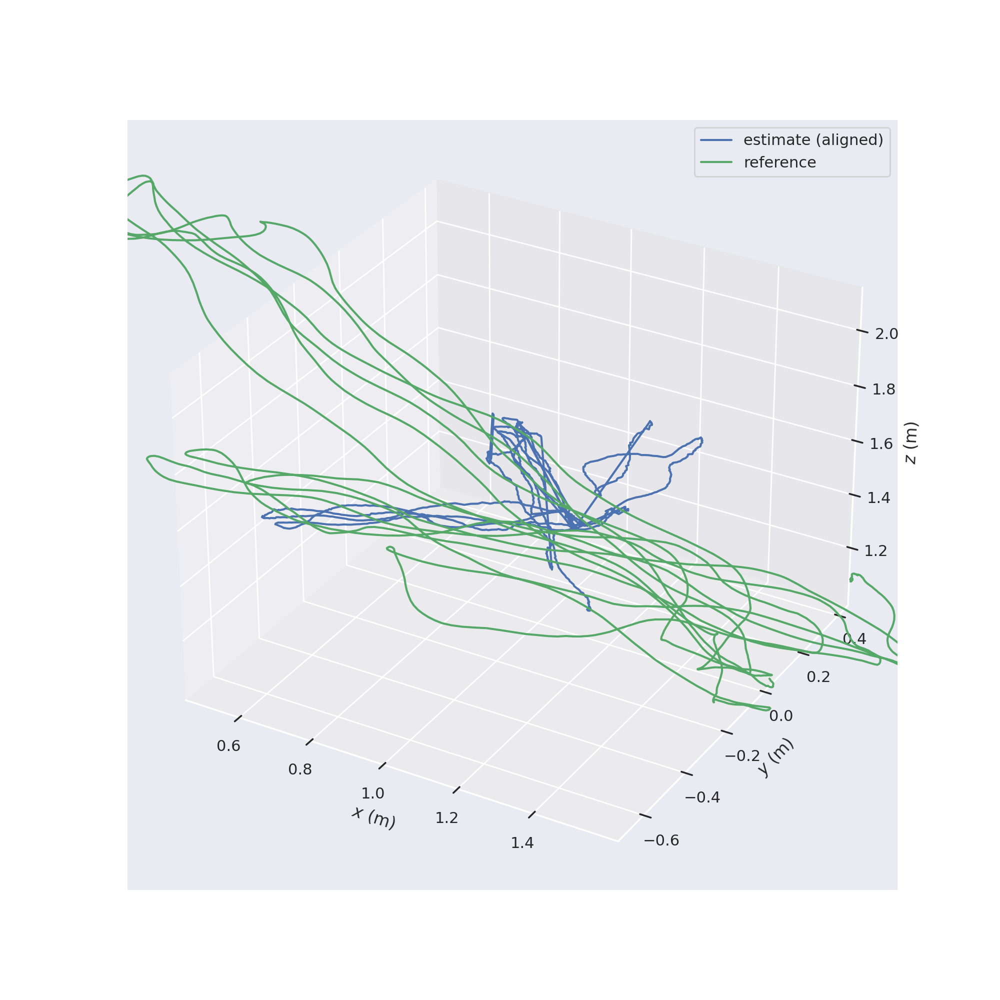

[DEBUG][2023-07-31 23:25:20,965][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:25:20,974][trajectory.align():214]
Rotation of alignment:
[[ 0.33771286  0.67702269 -0.65390389]
 [-0.27313995  0.73531493  0.62024714]
 [ 0.90074668 -0.03085816  0.43324726]]
Translation of alignment:
[ 1.23745685 -0.24663015  1.59551941]
[DEBUG][2023-07-31 23:25:20,974][trajectory.align():216]
Scale correction: 0.7371574653928735


<IPython.core.display.Javascript object>

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A2/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A2.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546


(mono_tum_vi:16569): Gtk-CRITICAL **: 23:27:04.904: IA__gtk_window_get_size: assertion 'GTK_IS_WINDOW (window)' failed

(mono_tum_vi:16569): Gtk-CRITICAL **: 23:27:04.904: IA__gtk_widget_get_screen: assertion 'GTK_IS_WIDGET (widget)' failed


[DEBUG][2023-07-31 23:27:08,067][file_interface.read_tum_trajectory_file():117]
Loaded 1945 stamps and poses from: ./logs/trajectory.txt
[DEBUG][2023-07-31 23:27:08,203][file_interface.read_tum_trajectory_file():117]
Loaded 30406 stamps and poses from: ./logs/ground_truth.txt
[DEBUG][2023-07-31 23:27:08,240][sync.associate_trajectories():110]
Found 1945 of max. 1945 possible matching timestamps between...
	first trajectory
and:	second trajectory
..with max. time diff.: 0.01 (s) and time offset: 0.0 (s).
[DEBUG][2023-07-31 23:27:08,241][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:27:08,246][trajectory.align():214]
Rotation of alignment:
[[-0.16664951  0.98222641  0.08636673]
 [ 0.74061036  0.18251722 -0.64667129]
 [-0.65094104 -0.04380336 -0.75786346]]
Translation of alignment:
[-0.59079818  2.17543121  1.2709917 ]
[DEBUG][2023-07-31 23:27:08,247][trajectory.align():216]
Scale correction: 2.139094470409687
[DEBUG][2023-07-31 2

/tmp/ipykernel_11700/2292642859.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=[10,10])


<IPython.core.display.Javascript object>


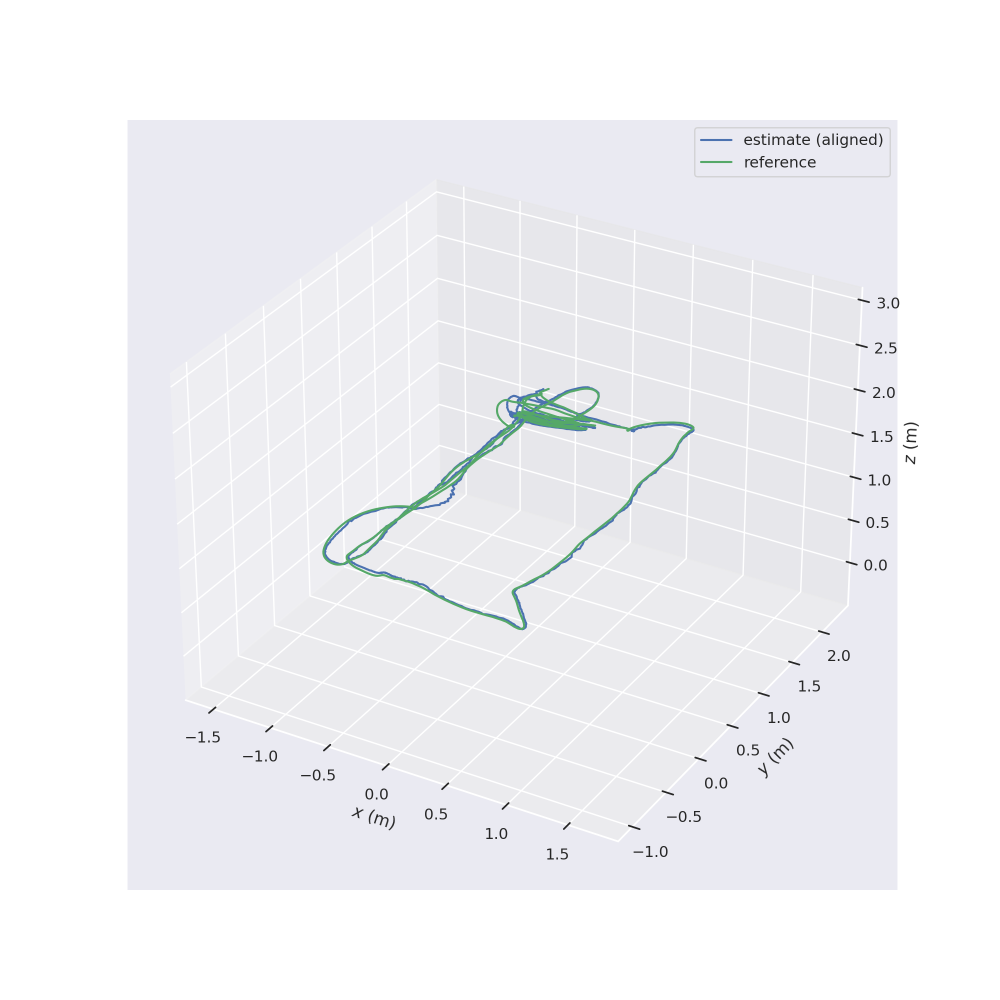

[DEBUG][2023-07-31 23:27:08,319][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:27:08,325][trajectory.align():214]
Rotation of alignment:
[[-0.16664951  0.98222641  0.08636673]
 [ 0.74061036  0.18251722 -0.64667129]
 [-0.65094104 -0.04380336 -0.75786346]]
Translation of alignment:
[-0.59079818  2.17543121  1.2709917 ]
[DEBUG][2023-07-31 23:27:08,325][trajectory.align():216]
Scale correction: 2.139094470409687


<IPython.core.display.Javascript object>


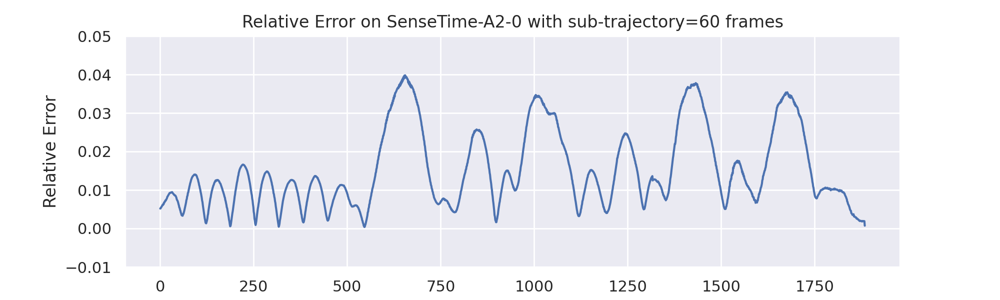

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A2/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A2.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>

[DEBUG][2023-07-31 23:28:54,510][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:28:54,516][trajectory.align():214]
Rotation of alignment:
[[-0.16249825  0.98286318  0.08703041]
 [ 0.746691    0.18014973 -0.64031135]
 [-0.64501695 -0.03906465 -0.76316911]]
Translation of alignment:
[-0.57286308  2.14643782  1.30229967]
[DEBUG][2023-07-31 23:28:54,517][trajectory.align():216]
Scale correction: 2.1324093257458876


<IPython.core.display.Javascript object>


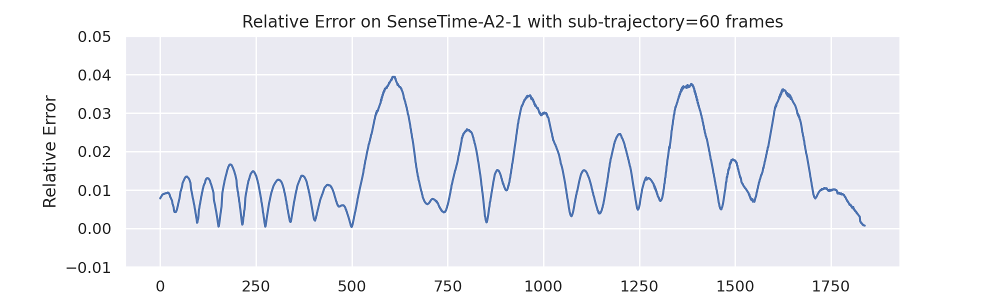

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A2/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A2.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>


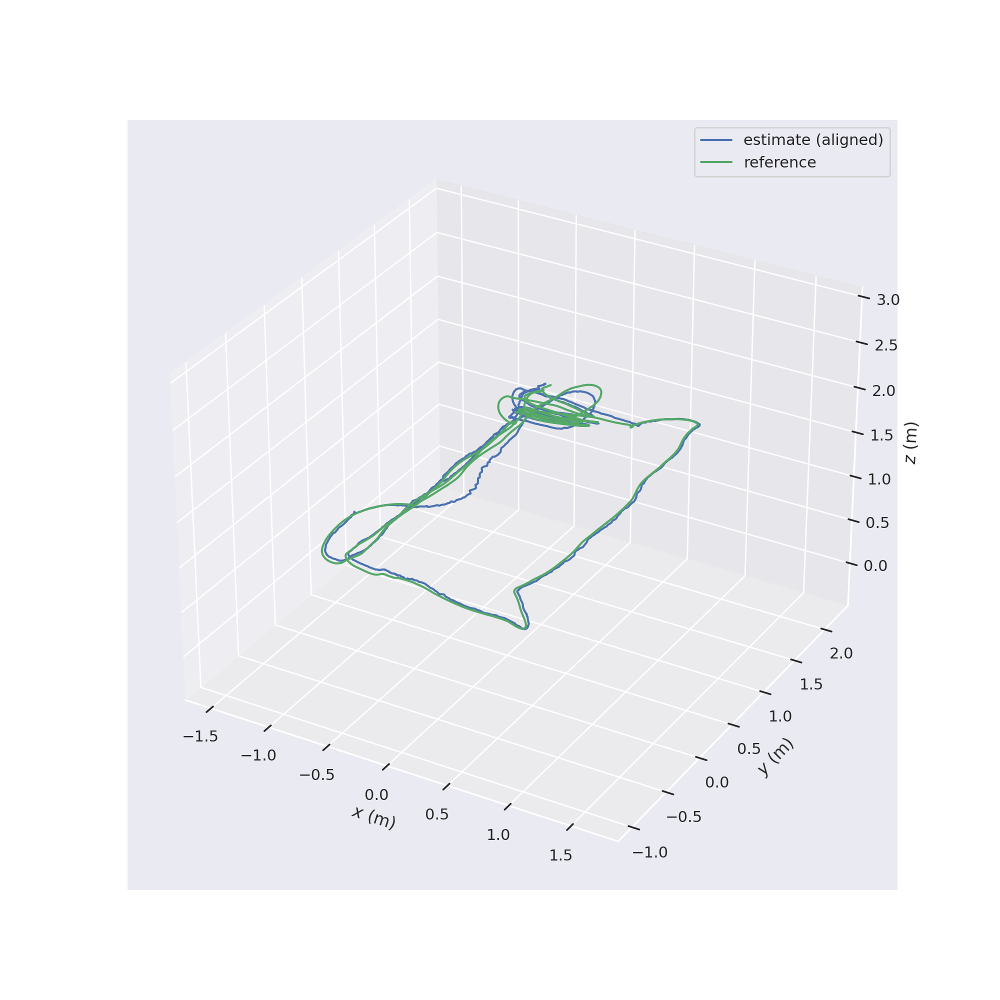

[DEBUG][2023-07-31 23:30:40,678][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:30:40,683][trajectory.align():214]
Rotation of alignment:
[[-0.17269191  0.98188773  0.07793584]
 [ 0.7403557   0.18158439 -0.64722527]
 [-0.64965448 -0.05407033 -0.75830433]]
Translation of alignment:
[-0.59777655  2.18838355  1.27828735]
[DEBUG][2023-07-31 23:30:40,684][trajectory.align():216]
Scale correction: 2.1220252519996845


<IPython.core.display.Javascript object>


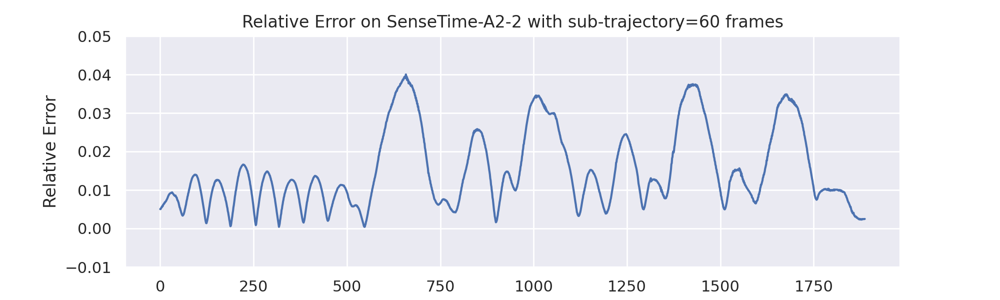

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A2/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A2.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>


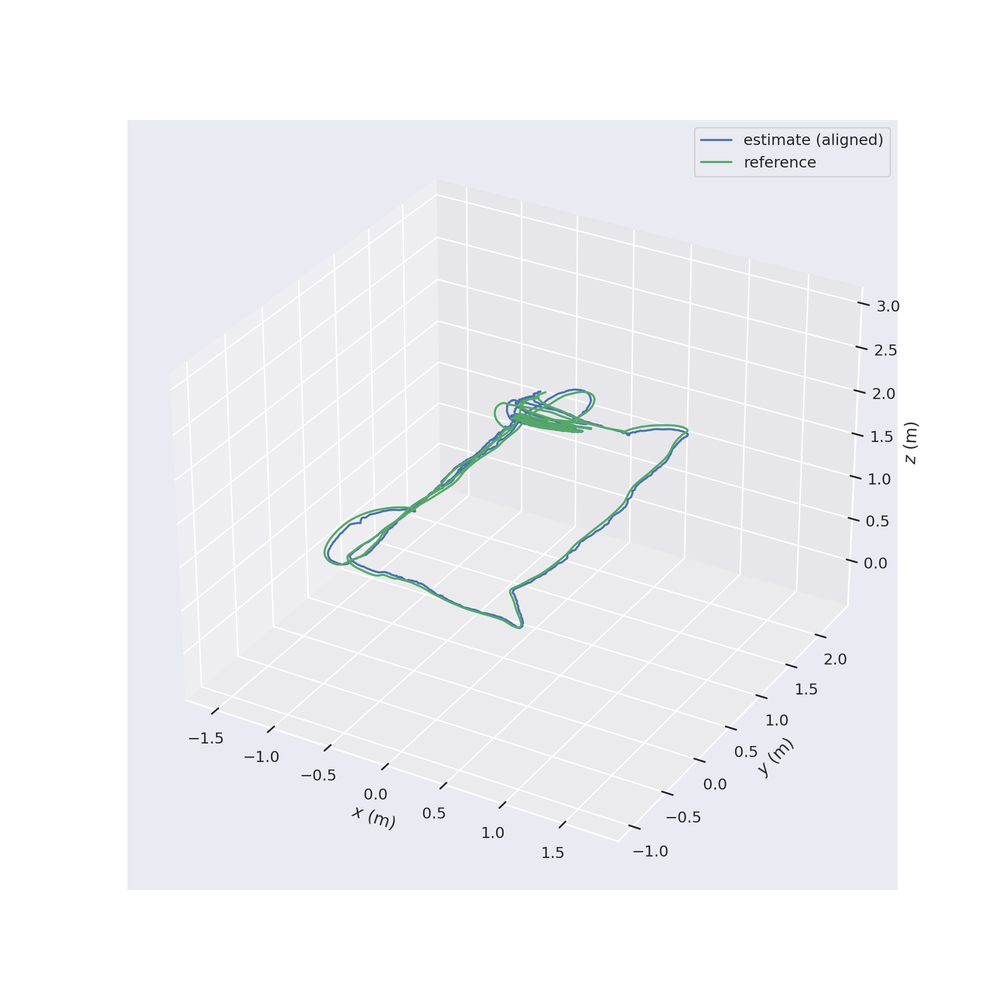

[DEBUG][2023-07-31 23:32:26,716][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:32:26,721][trajectory.align():214]
Rotation of alignment:
[[-0.16625958  0.98235296  0.08567623]
 [ 0.74287133  0.18191605 -0.64424276]
 [-0.64845966 -0.04346511 -0.76000714]]
Translation of alignment:
[-0.58369494  2.16638743  1.29015106]
[DEBUG][2023-07-31 23:32:26,722][trajectory.align():216]
Scale correction: 2.195629042717913


<IPython.core.display.Javascript object>

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A2/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A2.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

Segmentation fault (core dumped)


[DEBUG][2023-07-31 23:34:12,612][file_interface.read_tum_trajectory_file():117]
Loaded 1948 stamps and poses from: ./logs/trajectory.txt
[DEBUG][2023-07-31 23:34:12,697][file_interface.read_tum_trajectory_file():117]
Loaded 30406 stamps and poses from: ./logs/ground_truth.txt
[DEBUG][2023-07-31 23:34:12,735][sync.associate_trajectories():110]
Found 1948 of max. 1948 possible matching timestamps between...
	first trajectory
and:	second trajectory
..with max. time diff.: 0.01 (s) and time offset: 0.0 (s).
[DEBUG][2023-07-31 23:34:12,736][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:34:12,741][trajectory.align():214]
Rotation of alignment:
[[-0.18040972  0.980447    0.07858764]
 [ 0.73588727  0.18755836 -0.65060878]
 [-0.6526272  -0.05954451 -0.75533581]]
Translation of alignment:
[-0.52886531  2.00644096  1.27833574]
[DEBUG][2023-07-31 23:34:12,741][trajectory.align():216]
Scale correction: 1.9219533939784408
[DEBUG][2023-07-31 

<IPython.core.display.Javascript object>


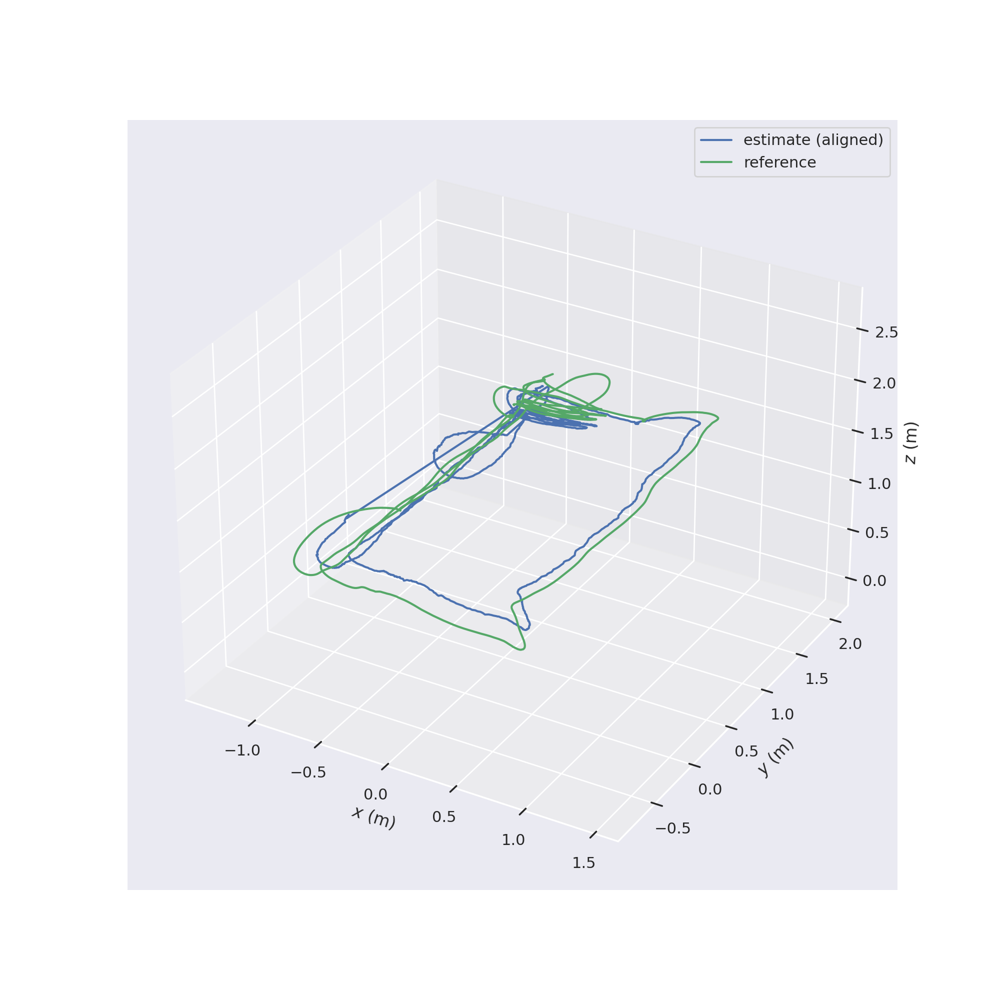

[DEBUG][2023-07-31 23:34:12,813][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:34:12,818][trajectory.align():214]
Rotation of alignment:
[[-0.18040972  0.980447    0.07858764]
 [ 0.73588727  0.18755836 -0.65060878]
 [-0.6526272  -0.05954451 -0.75533581]]
Translation of alignment:
[-0.52886531  2.00644096  1.27833574]
[DEBUG][2023-07-31 23:34:12,819][trajectory.align():216]
Scale correction: 1.9219533939784408


<IPython.core.display.Javascript object>


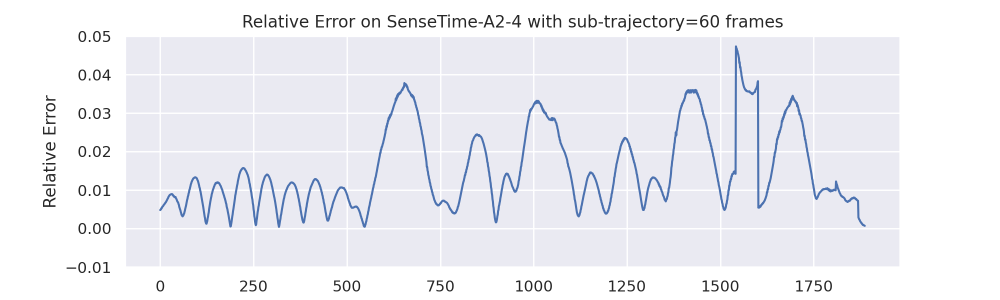

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A3/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A3.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>


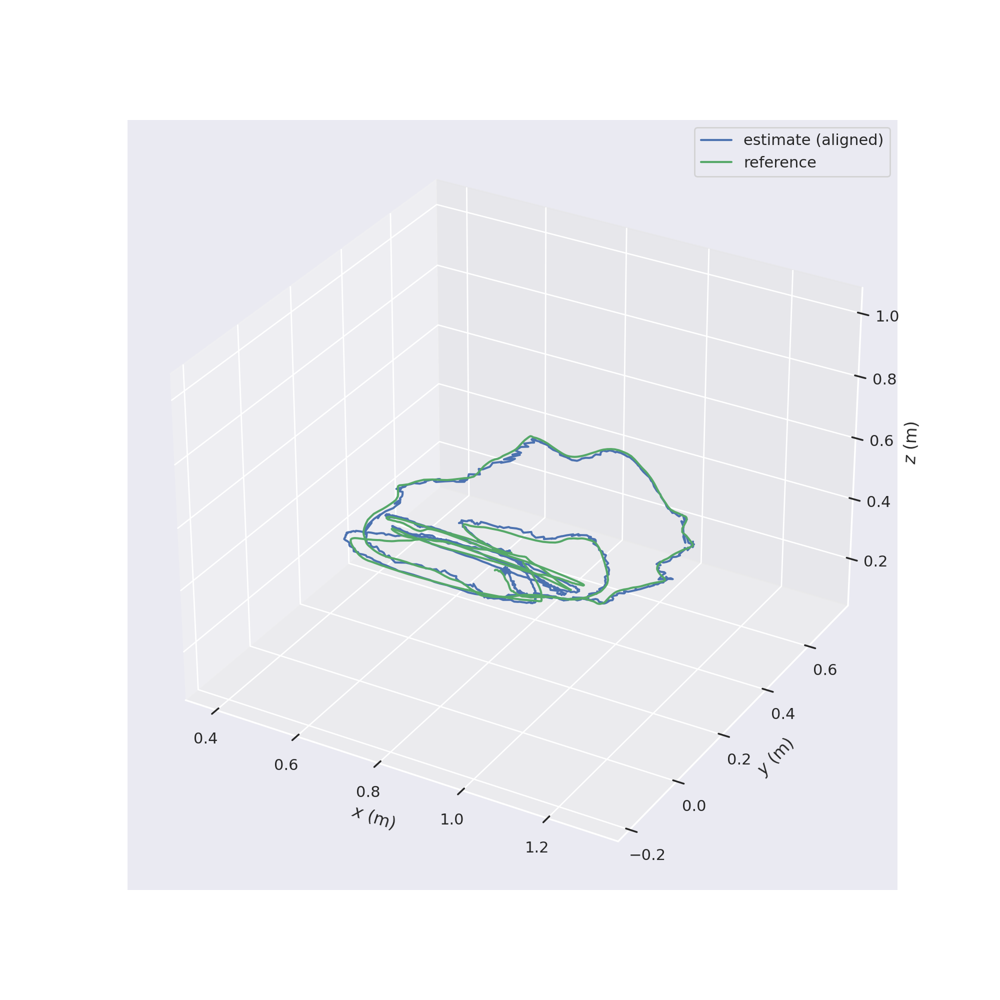

[DEBUG][2023-07-31 23:35:29,571][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:35:29,575][trajectory.align():214]
Rotation of alignment:
[[-0.94959996  0.28081677 -0.13929054]
 [ 0.3128415   0.82100911 -0.47757119]
 [-0.01975119 -0.49707744 -0.86748136]]
Translation of alignment:
[0.93886084 0.04022203 0.56501203]
[DEBUG][2023-07-31 23:35:29,575][trajectory.align():216]
Scale correction: 0.9087928906752378


<IPython.core.display.Javascript object>

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A3/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A3.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>


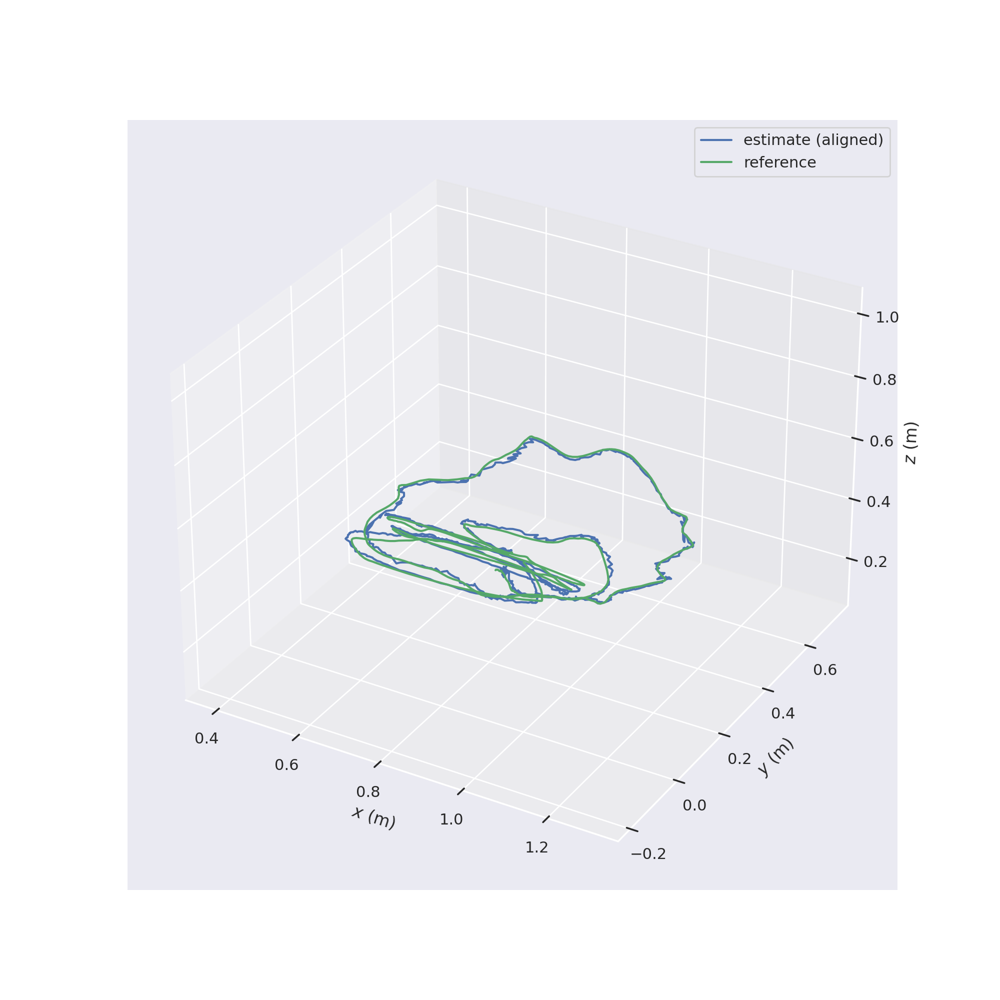

[DEBUG][2023-07-31 23:36:45,204][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:36:45,208][trajectory.align():214]
Rotation of alignment:
[[-0.94947833  0.28074981 -0.14025138]
 [ 0.31328727  0.82157851 -0.47629805]
 [-0.01849307 -0.49617365 -0.86802633]]
Translation of alignment:
[0.93906782 0.04174533 0.56522461]
[DEBUG][2023-07-31 23:36:45,208][trajectory.align():216]
Scale correction: 0.915342078994068


<IPython.core.display.Javascript object>


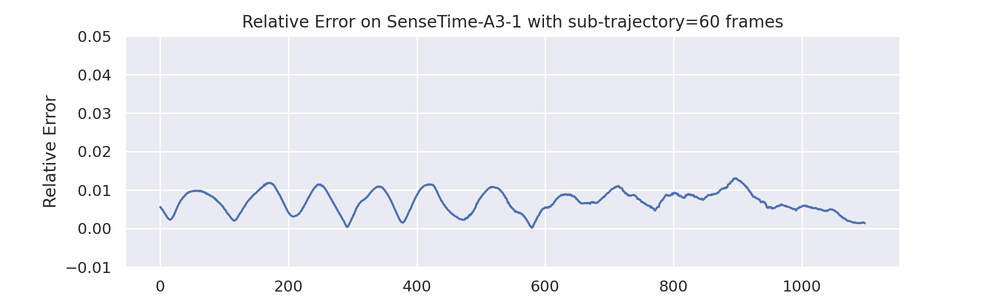

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A3/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A3.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>


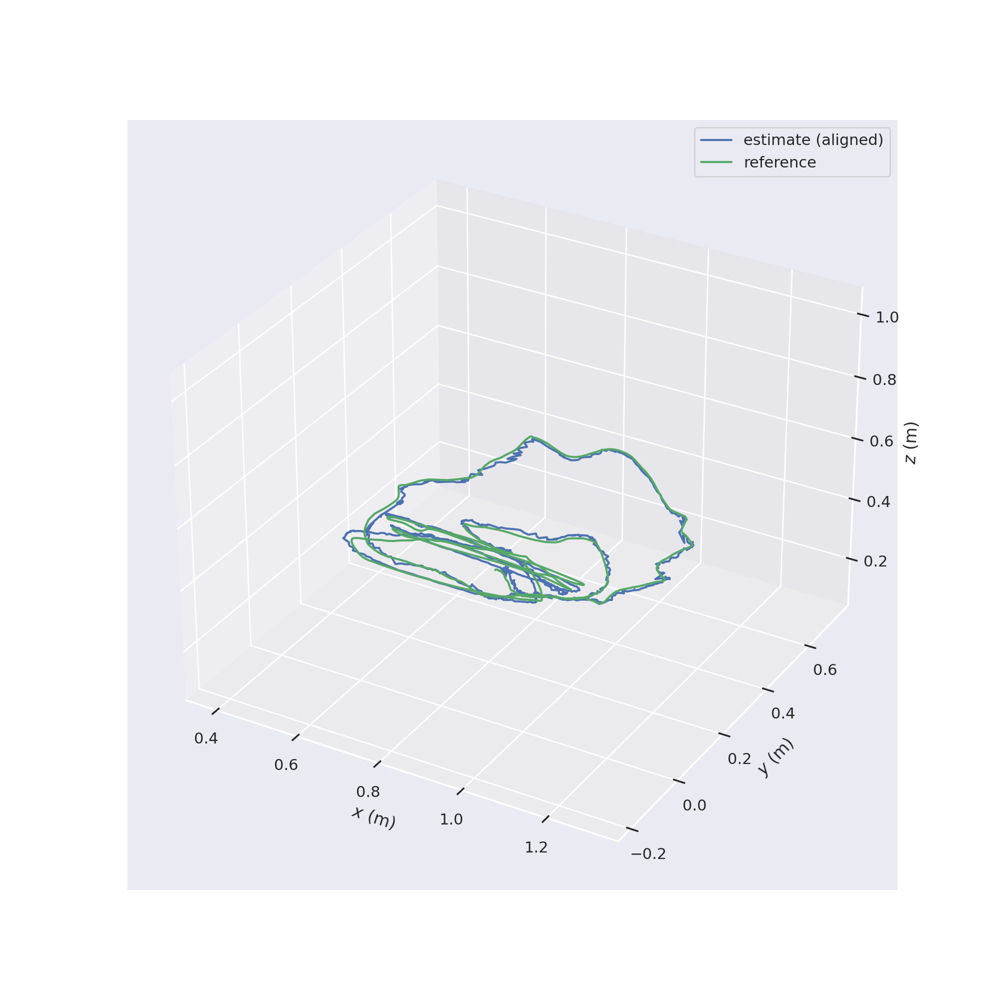

[DEBUG][2023-07-31 23:38:00,845][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:38:00,849][trajectory.align():214]
Rotation of alignment:
[[-0.94978982  0.27950105 -0.14063594]
 [ 0.31234514  0.82048482 -0.47879555]
 [-0.01843421 -0.49868209 -0.86658892]]
Translation of alignment:
[0.93865348 0.04136256 0.56555354]
[DEBUG][2023-07-31 23:38:00,849][trajectory.align():216]
Scale correction: 0.9362112878375719


<IPython.core.display.Javascript object>

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A3/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A3.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>


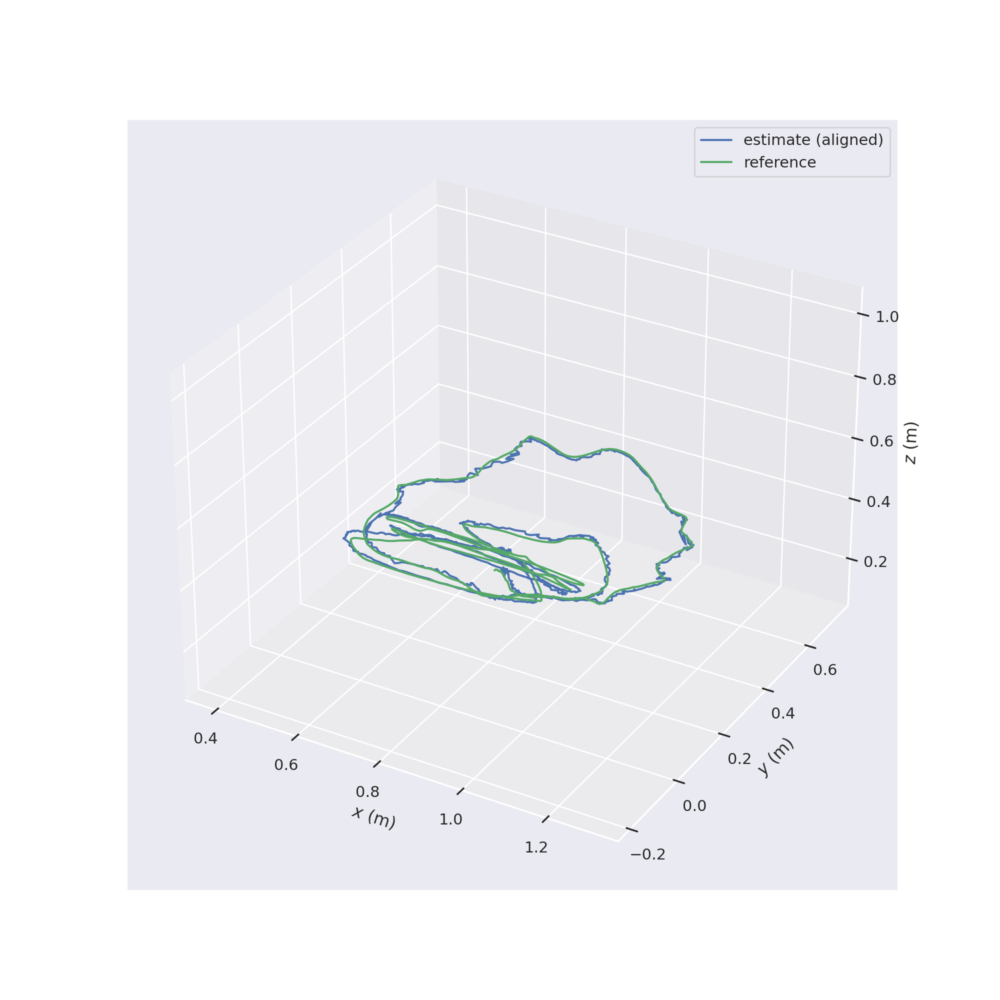

[DEBUG][2023-07-31 23:39:16,436][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:39:16,439][trajectory.align():214]
Rotation of alignment:
[[-0.94988332  0.27944206 -0.14012074]
 [ 0.31208846  0.82196374 -0.4764204 ]
 [-0.01795773 -0.49627386 -0.86798029]]
Translation of alignment:
[0.93855285 0.04217025 0.56533665]
[DEBUG][2023-07-31 23:39:16,439][trajectory.align():216]
Scale correction: 0.9221489137133403


<IPython.core.display.Javascript object>


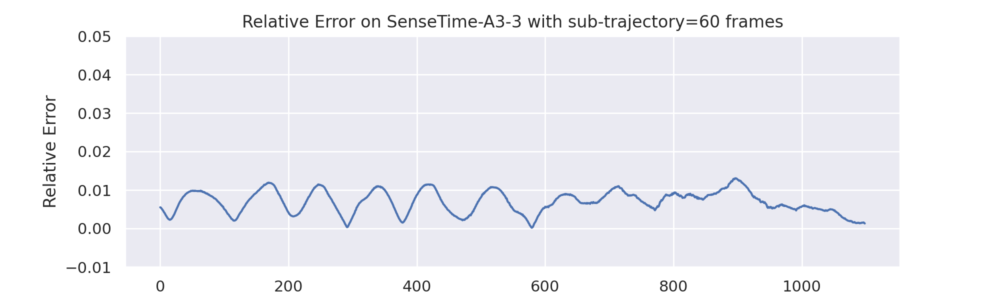

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A3/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A3.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>

[DEBUG][2023-07-31 23:40:32,152][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:40:32,159][trajectory.align():214]
Rotation of alignment:
[[-0.94965821  0.28082648 -0.13887323]
 [ 0.31270133  0.82255341 -0.4749987 ]
 [-0.01916157 -0.49451226 -0.86895941]]
Translation of alignment:
[0.93900544 0.0413755  0.56566818]
[DEBUG][2023-07-31 23:40:32,160][trajectory.align():216]
Scale correction: 0.919641728307024


<IPython.core.display.Javascript object>

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A4/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A4.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>


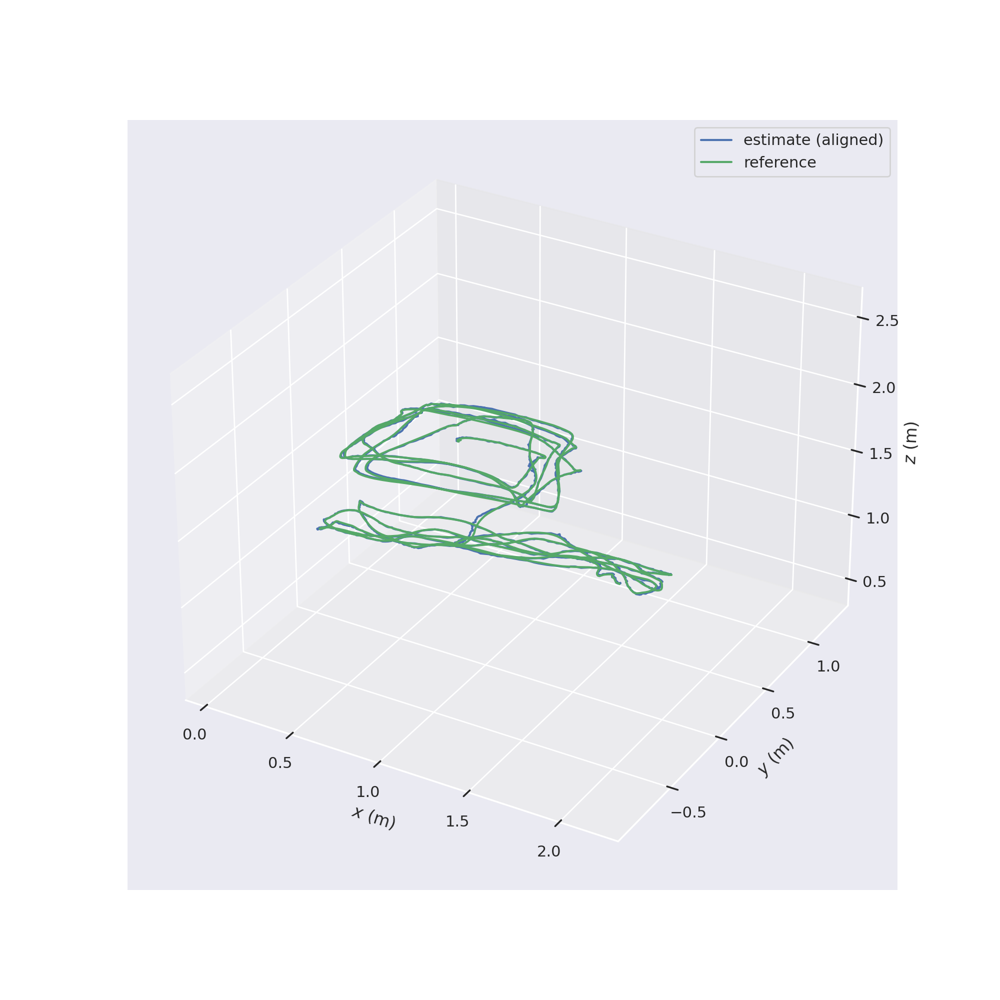

[DEBUG][2023-07-31 23:42:45,368][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:42:45,374][trajectory.align():214]
Rotation of alignment:
[[-0.51529448  0.81802255  0.25555958]
 [ 0.67765447  0.57146601 -0.46282936]
 [-0.52464847 -0.06531232 -0.84880992]]
Translation of alignment:
[0.43085882 0.71702545 1.31384729]
[DEBUG][2023-07-31 23:42:45,374][trajectory.align():216]
Scale correction: 1.0988837981598856


<IPython.core.display.Javascript object>

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A4/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A4.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546


(mono_tum_vi:21933): Gtk-CRITICAL **: 23:44:54.015: IA__gtk_window_get_size: assertion 'GTK_IS_WINDOW (window)' failed

(mono_tum_vi:21933): Gtk-CRITICAL **: 23:44:54.015: IA__gtk_widget_get_screen: assertion 'GTK_IS_WIDGET (widget)' failed


[DEBUG][2023-07-31 23:44:57,418][file_interface.read_tum_trajectory_file():117]
Loaded 2597 stamps and poses from: ./logs/trajectory.txt
[DEBUG][2023-07-31 23:44:57,604][file_interface.read_tum_trajectory_file():117]
Loaded 39539 stamps and poses from: ./logs/ground_truth.txt
[DEBUG][2023-07-31 23:44:57,671][sync.associate_trajectories():110]
Found 2597 of max. 2597 possible matching timestamps between...
	first trajectory
and:	second trajectory
..with max. time diff.: 0.01 (s) and time offset: 0.0 (s).
[DEBUG][2023-07-31 23:44:57,672][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:44:57,679][trajectory.align():214]
Rotation of alignment:
[[-0.51468389  0.81846287  0.25538015]
 [ 0.67767372  0.57080802 -0.46361248]
 [-0.52522264 -0.06554946 -0.84843647]]
Translation of alignment:
[0.43111539 0.71634931 1.31415116]
[DEBUG][2023-07-31 23:44:57,680][trajectory.align():216]
Scale correction: 1.1634191882016225
[DEBUG][2023-07-31 23:

<IPython.core.display.Javascript object>


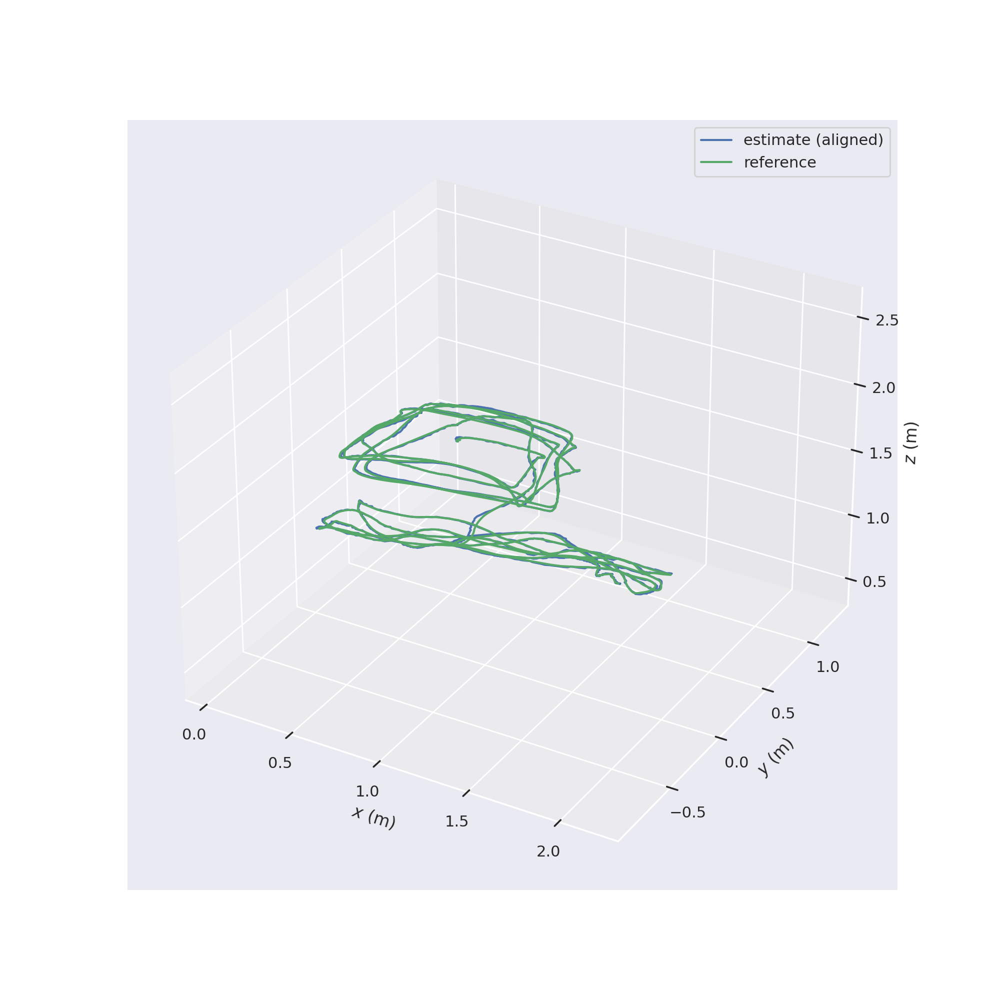

[DEBUG][2023-07-31 23:44:57,776][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:44:57,782][trajectory.align():214]
Rotation of alignment:
[[-0.51468389  0.81846287  0.25538015]
 [ 0.67767372  0.57080802 -0.46361248]
 [-0.52522264 -0.06554946 -0.84843647]]
Translation of alignment:
[0.43111539 0.71634931 1.31415116]
[DEBUG][2023-07-31 23:44:57,783][trajectory.align():216]
Scale correction: 1.1634191882016225


<IPython.core.display.Javascript object>


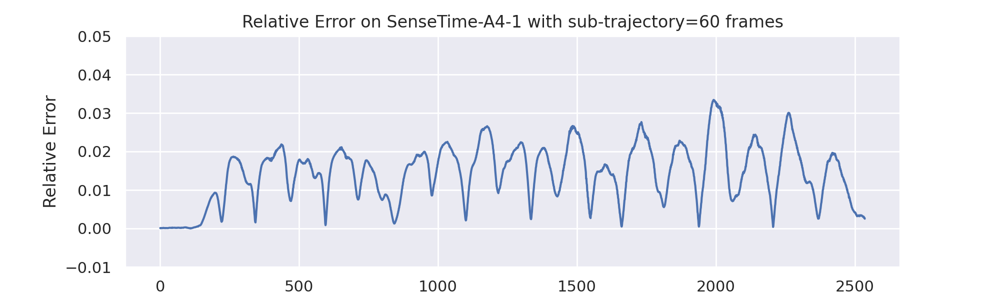

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A4/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A4.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546


(mono_tum_vi:22603): Gtk-CRITICAL **: 23:47:06.434: IA__gtk_window_get_size: assertion 'GTK_IS_WINDOW (window)' failed

(mono_tum_vi:22603): Gtk-CRITICAL **: 23:47:06.434: IA__gtk_widget_get_screen: assertion 'GTK_IS_WIDGET (widget)' failed


[DEBUG][2023-07-31 23:47:09,628][file_interface.read_tum_trajectory_file():117]
Loaded 2593 stamps and poses from: ./logs/trajectory.txt
[DEBUG][2023-07-31 23:47:09,739][file_interface.read_tum_trajectory_file():117]
Loaded 39539 stamps and poses from: ./logs/ground_truth.txt
[DEBUG][2023-07-31 23:47:09,805][sync.associate_trajectories():110]
Found 2593 of max. 2593 possible matching timestamps between...
	first trajectory
and:	second trajectory
..with max. time diff.: 0.01 (s) and time offset: 0.0 (s).
[DEBUG][2023-07-31 23:47:09,806][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:47:09,813][trajectory.align():214]
Rotation of alignment:
[[-0.51684389  0.81717105  0.25515462]
 [ 0.67596908  0.57244305 -0.46408486]
 [-0.5252982  -0.06738279 -0.84824605]]
Translation of alignment:
[0.42957368 0.71788595 1.31370538]
[DEBUG][2023-07-31 23:47:09,813][trajectory.align():216]
Scale correction: 1.1483128343505808
[DEBUG][2023-07-31 23:

<IPython.core.display.Javascript object>

[DEBUG][2023-07-31 23:47:09,910][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:47:09,916][trajectory.align():214]
Rotation of alignment:
[[-0.51684389  0.81717105  0.25515462]
 [ 0.67596908  0.57244305 -0.46408486]
 [-0.5252982  -0.06738279 -0.84824605]]
Translation of alignment:
[0.42957368 0.71788595 1.31370538]
[DEBUG][2023-07-31 23:47:09,917][trajectory.align():216]
Scale correction: 1.1483128343505808


<IPython.core.display.Javascript object>


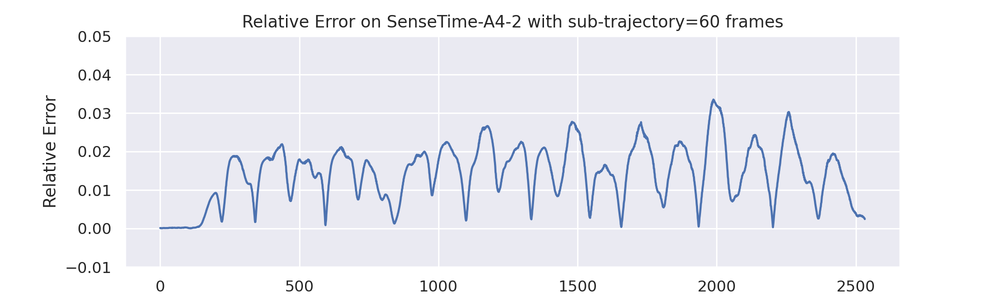

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A4/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A4.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

Segmentation fault (core dumped)


[DEBUG][2023-07-31 23:49:21,801][file_interface.read_tum_trajectory_file():117]
Loaded 2589 stamps and poses from: ./logs/trajectory.txt
[DEBUG][2023-07-31 23:49:21,913][file_interface.read_tum_trajectory_file():117]
Loaded 39539 stamps and poses from: ./logs/ground_truth.txt
[DEBUG][2023-07-31 23:49:21,980][sync.associate_trajectories():110]
Found 2589 of max. 2589 possible matching timestamps between...
	first trajectory
and:	second trajectory
..with max. time diff.: 0.01 (s) and time offset: 0.0 (s).
[DEBUG][2023-07-31 23:49:21,981][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:49:21,987][trajectory.align():214]
Rotation of alignment:
[[-0.51548577  0.81813865  0.25480105]
 [ 0.67711445  0.57114362 -0.46401615]
 [-0.52515754 -0.06666425 -0.84838991]]
Translation of alignment:
[0.430536   0.7164334  1.31384445]
[DEBUG][2023-07-31 23:49:21,988][trajectory.align():216]
Scale correction: 1.1260719630063762
[DEBUG][2023-07-31 23:

<IPython.core.display.Javascript object>


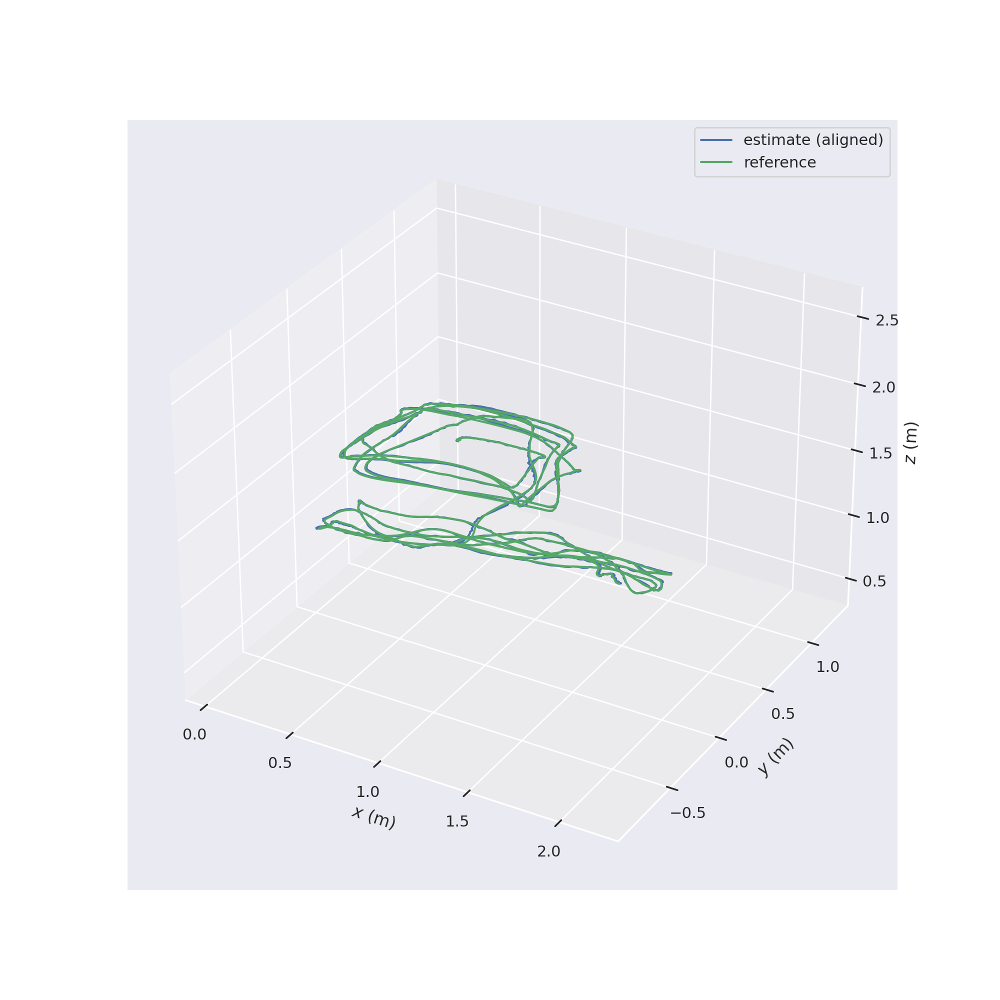

[DEBUG][2023-07-31 23:49:22,083][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:49:22,090][trajectory.align():214]
Rotation of alignment:
[[-0.51548577  0.81813865  0.25480105]
 [ 0.67711445  0.57114362 -0.46401615]
 [-0.52515754 -0.06666425 -0.84838991]]
Translation of alignment:
[0.430536   0.7164334  1.31384445]
[DEBUG][2023-07-31 23:49:22,091][trajectory.align():216]
Scale correction: 1.1260719630063762


<IPython.core.display.Javascript object>

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A4/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A4.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>

[DEBUG][2023-07-31 23:51:34,271][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:51:34,278][trajectory.align():214]
Rotation of alignment:
[[-0.51525301  0.8177109   0.25663829]
 [ 0.67495241  0.57170099 -0.46647318]
 [-0.52816057 -0.06713308 -0.8464866 ]]
Translation of alignment:
[0.43008324 0.71770935 1.3128739 ]
[DEBUG][2023-07-31 23:51:34,279][trajectory.align():216]
Scale correction: 1.0961416200773983


<IPython.core.display.Javascript object>


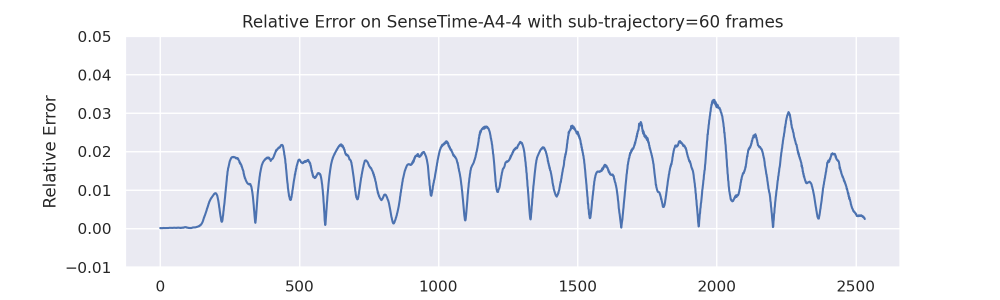

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A5/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A5.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>


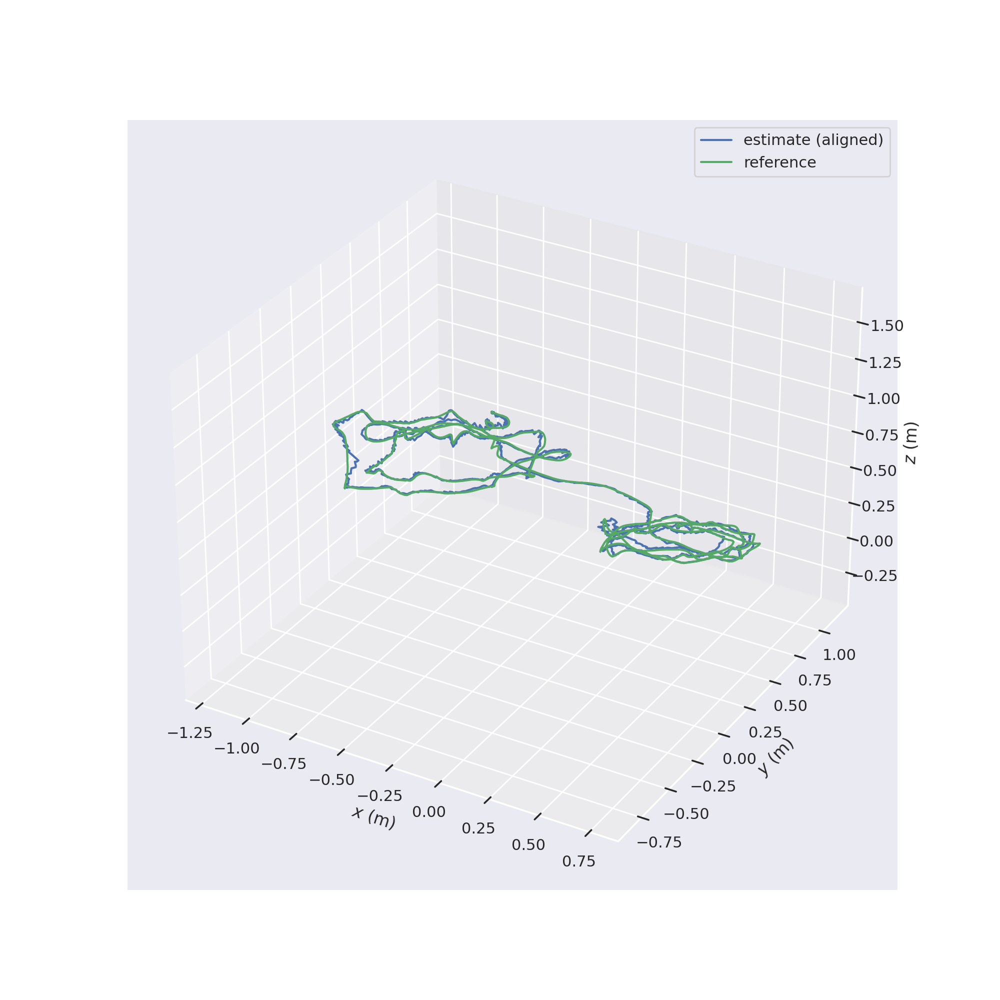

[DEBUG][2023-07-31 23:53:24,880][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:53:24,885][trajectory.align():214]
Rotation of alignment:
[[-5.14215188e-01  8.39138917e-01  1.77281182e-01]
 [ 7.92805363e-01  5.43916496e-01 -2.74980911e-01]
 [-3.27173343e-01 -8.49889017e-04 -9.44963958e-01]]
Translation of alignment:
[0.38662537 0.51846989 0.4126646 ]
[DEBUG][2023-07-31 23:53:24,886][trajectory.align():216]
Scale correction: 0.964438335670795


<IPython.core.display.Javascript object>

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A5/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A5.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546


(mono_tum_vi:24825): Gtk-CRITICAL **: 23:55:11.098: IA__gtk_window_get_size: assertion 'GTK_IS_WINDOW (window)' failed

(mono_tum_vi:24825): Gtk-CRITICAL **: 23:55:11.098: IA__gtk_widget_get_screen: assertion 'GTK_IS_WIDGET (widget)' failed


[DEBUG][2023-07-31 23:55:14,260][file_interface.read_tum_trajectory_file():117]
Loaded 2171 stamps and poses from: ./logs/trajectory.txt
[DEBUG][2023-07-31 23:55:14,346][file_interface.read_tum_trajectory_file():117]
Loaded 30838 stamps and poses from: ./logs/ground_truth.txt
[DEBUG][2023-07-31 23:55:14,389][sync.associate_trajectories():110]
Found 2171 of max. 2171 possible matching timestamps between...
	first trajectory
and:	second trajectory
..with max. time diff.: 0.01 (s) and time offset: 0.0 (s).
[DEBUG][2023-07-31 23:55:14,390][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:55:14,395][trajectory.align():214]
Rotation of alignment:
[[-5.21636045e-01  8.35034414e-01  1.74966755e-01]
 [ 7.91678322e-01  5.50197717e-01 -2.65570906e-01]
 [-3.18027155e-01 -1.39698536e-05 -9.48081604e-01]]
Translation of alignment:
[0.38416478 0.51908398 0.41407972]
[DEBUG][2023-07-31 23:55:14,395][trajectory.align():216]
Scale correction: 0.934

<IPython.core.display.Javascript object>


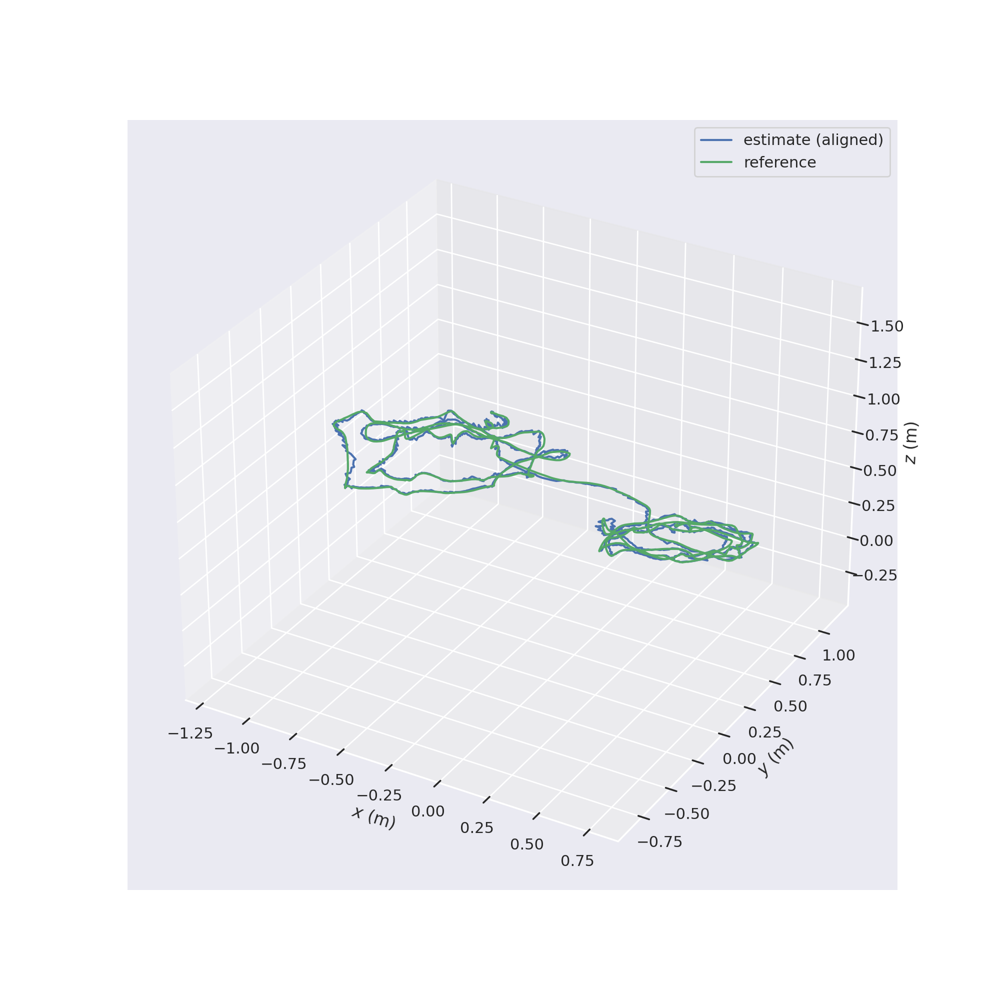

[DEBUG][2023-07-31 23:55:14,476][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-07-31 23:55:14,482][trajectory.align():214]
Rotation of alignment:
[[-5.21636045e-01  8.35034414e-01  1.74966755e-01]
 [ 7.91678322e-01  5.50197717e-01 -2.65570906e-01]
 [-3.18027155e-01 -1.39698536e-05 -9.48081604e-01]]
Translation of alignment:
[0.38416478 0.51908398 0.41407972]
[DEBUG][2023-07-31 23:55:14,482][trajectory.align():216]
Scale correction: 0.9340296766369968


<IPython.core.display.Javascript object>


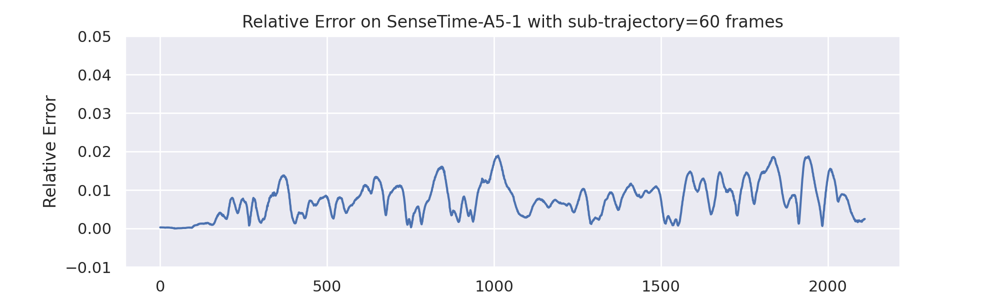

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A5/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A5.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

Segmentation fault (core dumped)


[DEBUG][2023-08-01 00:00:05,480][file_interface.read_tum_trajectory_file():117]
Loaded 2171 stamps and poses from: ./logs/trajectory.txt
[DEBUG][2023-08-01 00:00:06,839][file_interface.read_tum_trajectory_file():117]
Loaded 30838 stamps and poses from: ./logs/ground_truth.txt
[DEBUG][2023-08-01 00:00:07,315][sync.associate_trajectories():110]
Found 2171 of max. 2171 possible matching timestamps between...
	first trajectory
and:	second trajectory
..with max. time diff.: 0.01 (s) and time offset: 0.0 (s).
[DEBUG][2023-08-01 00:00:07,321][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 00:00:07,382][trajectory.align():214]
Rotation of alignment:
[[-0.51891948  0.83323875  0.19088151]
 [ 0.79340118  0.55258742 -0.25526791]
 [-0.31817784  0.01898212 -0.94784099]]
Translation of alignment:
[0.38001239 0.51988578 0.41601743]
[DEBUG][2023-08-01 00:00:07,388][trajectory.align():216]
Scale correction: 1.1843110698715935
[DEBUG][2023-08-01 00:

<IPython.core.display.Javascript object>


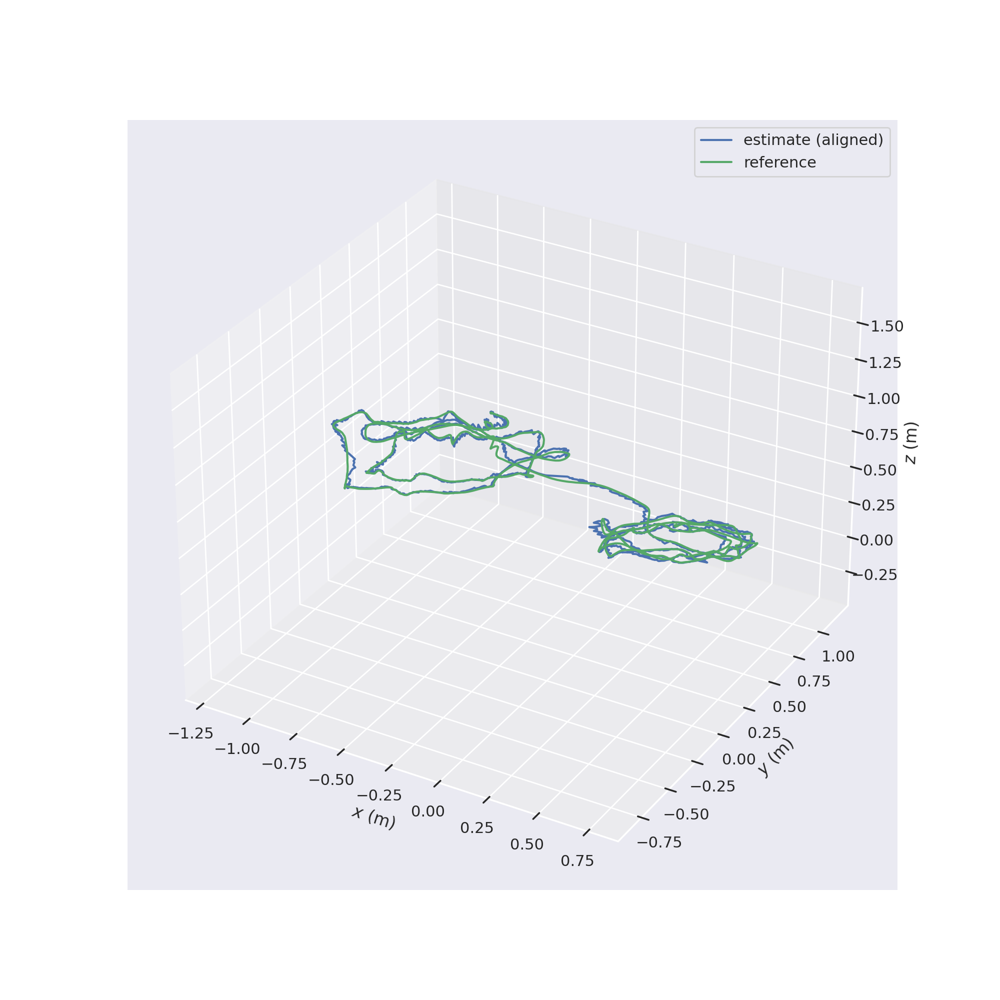

[DEBUG][2023-08-01 00:00:08,310][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 00:00:08,374][trajectory.align():214]
Rotation of alignment:
[[-0.51891948  0.83323875  0.19088151]
 [ 0.79340118  0.55258742 -0.25526791]
 [-0.31817784  0.01898212 -0.94784099]]
Translation of alignment:
[0.38001239 0.51988578 0.41601743]
[DEBUG][2023-08-01 00:00:08,379][trajectory.align():216]
Scale correction: 1.1843110698715935


<IPython.core.display.Javascript object>


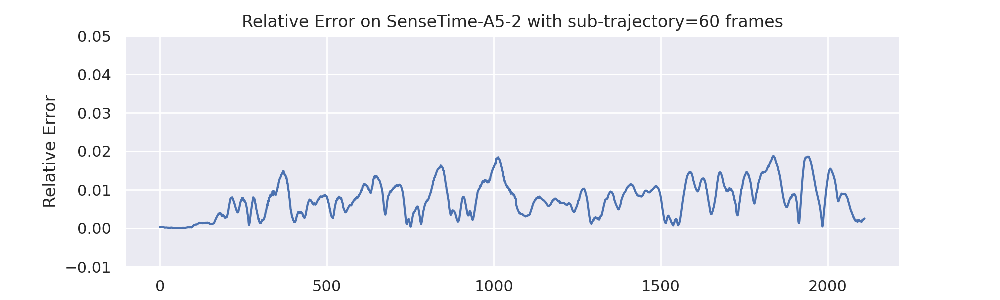

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A5/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A5.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>


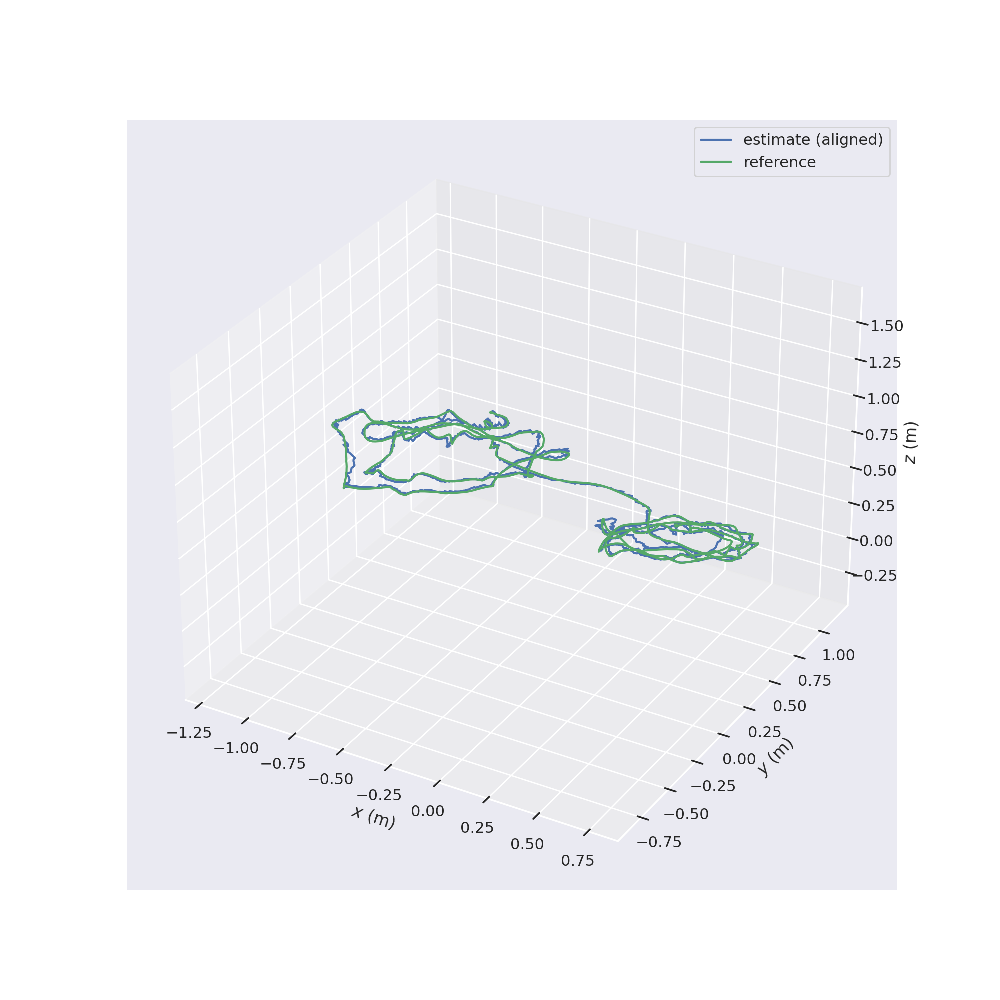

[DEBUG][2023-08-01 00:06:58,128][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 00:06:58,192][trajectory.align():214]
Rotation of alignment:
[[-0.51261569  0.84168672  0.1696721 ]
 [ 0.79322658  0.53987746 -0.28164501]
 [-0.32865901 -0.00978724 -0.94439794]]
Translation of alignment:
[0.38821047 0.51955721 0.41279583]
[DEBUG][2023-08-01 00:06:58,197][trajectory.align():216]
Scale correction: 0.9862184612398639


<IPython.core.display.Javascript object>

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A5/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A5.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>


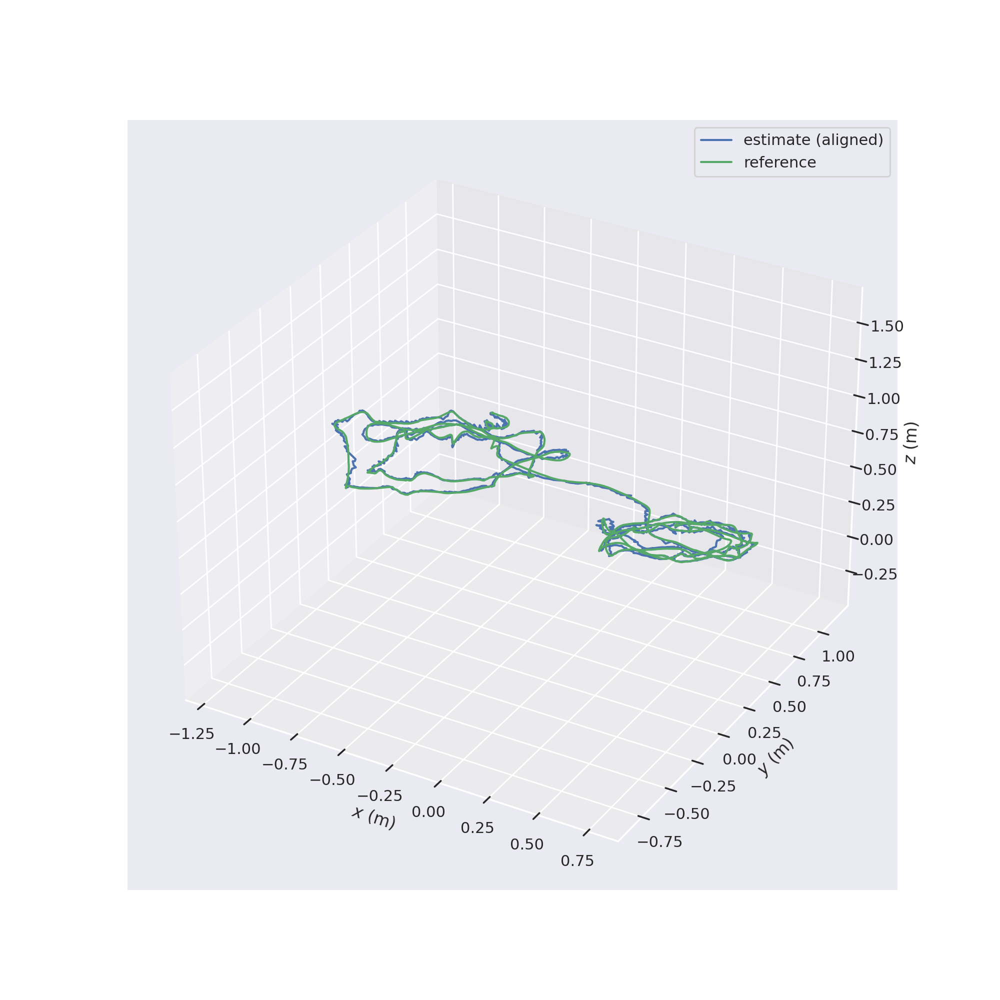

[DEBUG][2023-08-01 00:13:49,449][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 00:13:49,513][trajectory.align():214]
Rotation of alignment:
[[-5.15080687e-01  8.38735129e-01  1.76678432e-01]
 [ 7.93707550e-01  5.44539294e-01 -2.71118575e-01]
 [-3.23605022e-01  5.83063528e-04 -9.46192079e-01]]
Translation of alignment:
[0.38621059 0.51987952 0.41229942]
[DEBUG][2023-08-01 00:13:49,518][trajectory.align():216]
Scale correction: 0.8953708271932495


<IPython.core.display.Javascript object>


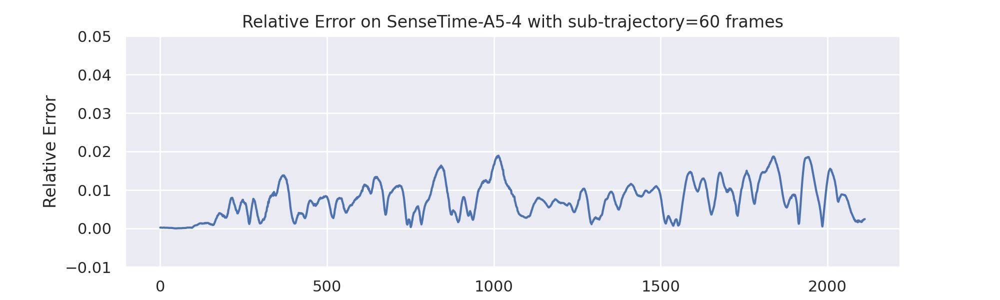

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A6/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A6.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>

[DEBUG][2023-08-01 00:20:17,755][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 00:20:17,817][trajectory.align():214]
Rotation of alignment:
[[ 0.06979863  0.90288791 -0.42417164]
 [ 0.98900509 -0.00706136  0.14771281]
 [ 0.13037289 -0.42981806 -0.89345361]]
Translation of alignment:
[0.83398681 0.24556411 0.49113103]
[DEBUG][2023-08-01 00:20:17,822][trajectory.align():216]
Scale correction: 0.9440892078354692


<IPython.core.display.Javascript object>

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A6/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A6.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

pure virtual method called
terminate called without an active exception
Aborted (core dumped)


[DEBUG][2023-08-01 00:26:42,777][file_interface.read_tum_trajectory_file():117]
Loaded 2080 stamps and poses from: ./logs/trajectory.txt
[DEBUG][2023-08-01 00:26:43,692][file_interface.read_tum_trajectory_file():117]
Loaded 29157 stamps and poses from: ./logs/ground_truth.txt
[DEBUG][2023-08-01 00:26:44,121][sync.associate_trajectories():110]
Found 2080 of max. 2080 possible matching timestamps between...
	first trajectory
and:	second trajectory
..with max. time diff.: 0.01 (s) and time offset: 0.0 (s).
[DEBUG][2023-08-01 00:26:44,126][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 00:26:44,184][trajectory.align():214]
Rotation of alignment:
[[ 0.07023276  0.9042709  -0.42114309]
 [ 0.9888422  -0.00751168  0.14877729]
 [ 0.13137148 -0.42689309 -0.89470879]]
Translation of alignment:
[0.8341263  0.24668614 0.49208505]
[DEBUG][2023-08-01 00:26:44,190][trajectory.align():216]
Scale correction: 0.9873570403051157
[DEBUG][2023-08-01 00:

<IPython.core.display.Javascript object>


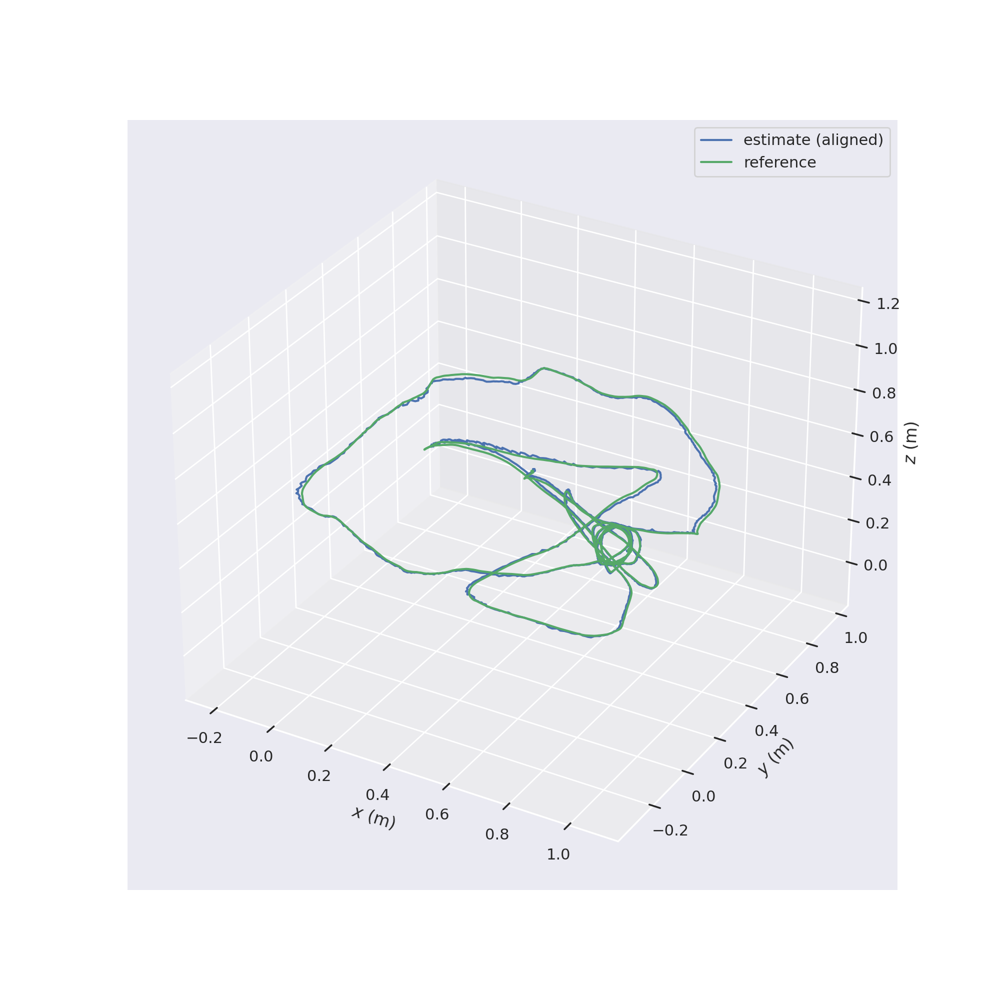

[DEBUG][2023-08-01 00:26:45,079][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 00:26:45,149][trajectory.align():214]
Rotation of alignment:
[[ 0.07023276  0.9042709  -0.42114309]
 [ 0.9888422  -0.00751168  0.14877729]
 [ 0.13137148 -0.42689309 -0.89470879]]
Translation of alignment:
[0.8341263  0.24668614 0.49208505]
[DEBUG][2023-08-01 00:26:45,154][trajectory.align():216]
Scale correction: 0.9873570403051157


<IPython.core.display.Javascript object>


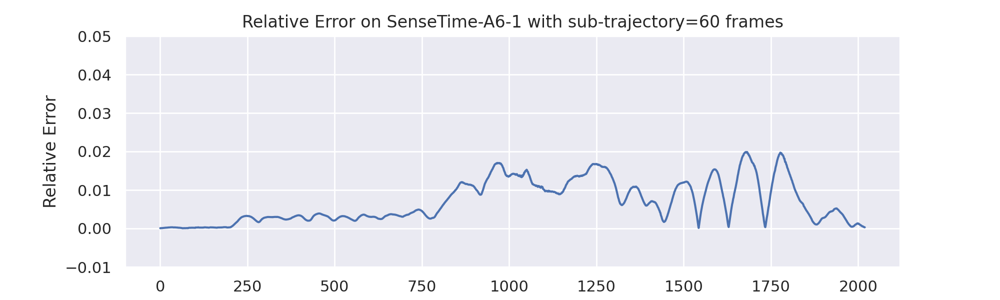

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A6/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A6.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

Segmentation fault (core dumped)


[DEBUG][2023-08-01 00:33:14,814][file_interface.read_tum_trajectory_file():117]
Loaded 2080 stamps and poses from: ./logs/trajectory.txt
[DEBUG][2023-08-01 00:33:15,731][file_interface.read_tum_trajectory_file():117]
Loaded 29157 stamps and poses from: ./logs/ground_truth.txt
[DEBUG][2023-08-01 00:33:16,155][sync.associate_trajectories():110]
Found 2080 of max. 2080 possible matching timestamps between...
	first trajectory
and:	second trajectory
..with max. time diff.: 0.01 (s) and time offset: 0.0 (s).
[DEBUG][2023-08-01 00:33:16,161][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 00:33:16,218][trajectory.align():214]
Rotation of alignment:
[[ 0.07041403  0.90318791 -0.42343059]
 [ 0.98922262 -0.00859586  0.14616675]
 [ 0.12837629 -0.42915931 -0.89405918]]
Translation of alignment:
[0.83454987 0.24563686 0.49114192]
[DEBUG][2023-08-01 00:33:16,223][trajectory.align():216]
Scale correction: 0.9801628723178795
[DEBUG][2023-08-01 00:

<IPython.core.display.Javascript object>


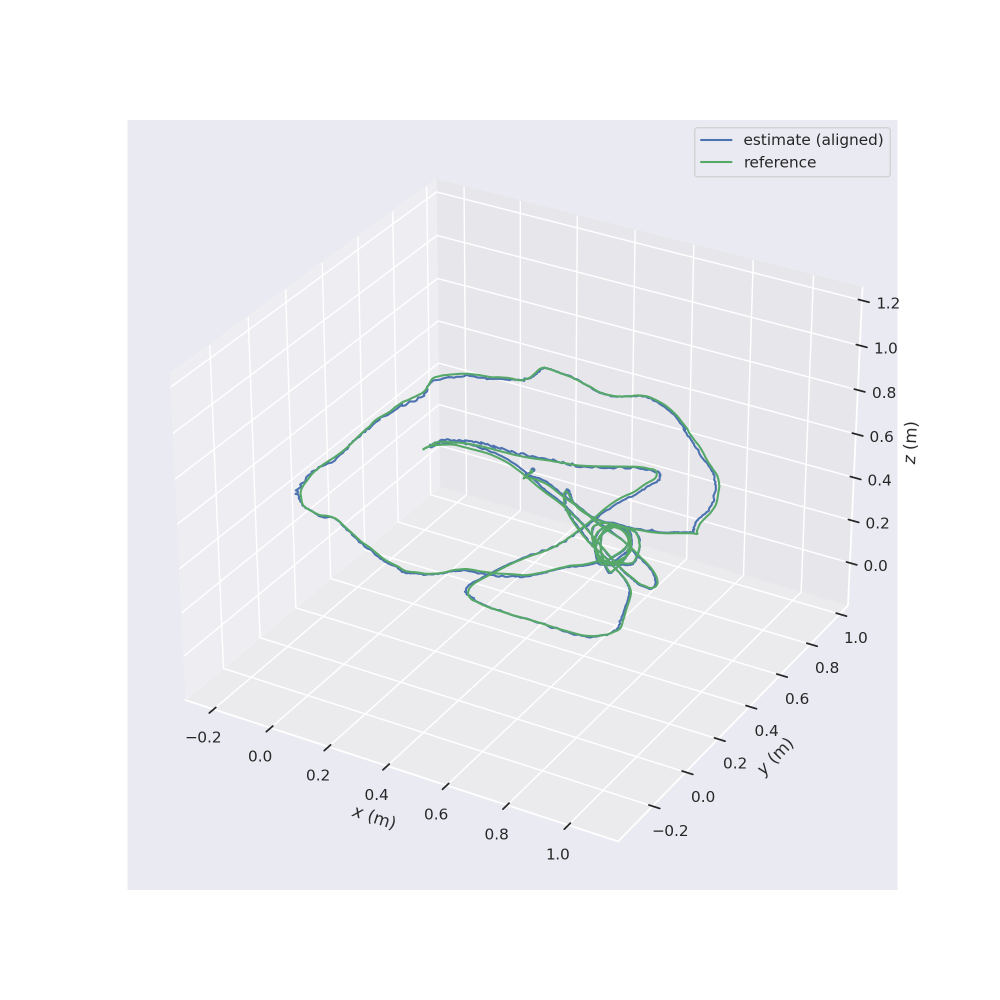

[DEBUG][2023-08-01 00:33:17,113][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 00:33:17,174][trajectory.align():214]
Rotation of alignment:
[[ 0.07041403  0.90318791 -0.42343059]
 [ 0.98922262 -0.00859586  0.14616675]
 [ 0.12837629 -0.42915931 -0.89405918]]
Translation of alignment:
[0.83454987 0.24563686 0.49114192]
[DEBUG][2023-08-01 00:33:17,180][trajectory.align():216]
Scale correction: 0.9801628723178795


<IPython.core.display.Javascript object>


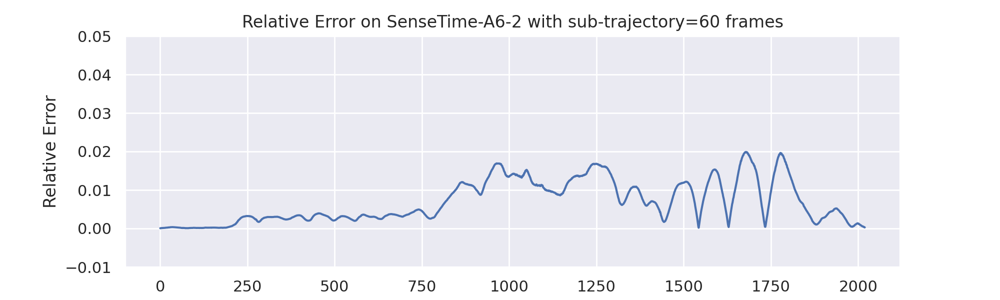

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A6/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A6.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>

[DEBUG][2023-08-01 00:39:53,153][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 00:39:53,214][trajectory.align():214]
Rotation of alignment:
[[ 0.0701813   0.90372498 -0.42232186]
 [ 0.98920639 -0.00845903  0.14628453]
 [ 0.12862855 -0.42802992 -0.89456419]]
Translation of alignment:
[0.83406069 0.24532857 0.49136535]
[DEBUG][2023-08-01 00:39:53,220][trajectory.align():216]
Scale correction: 0.9073977497867877


<IPython.core.display.Javascript object>

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A6/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A6.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

Segmentation fault (core dumped)


[DEBUG][2023-08-01 00:46:14,504][file_interface.read_tum_trajectory_file():117]
Loaded 2080 stamps and poses from: ./logs/trajectory.txt
[DEBUG][2023-08-01 00:46:15,429][file_interface.read_tum_trajectory_file():117]
Loaded 29157 stamps and poses from: ./logs/ground_truth.txt
[DEBUG][2023-08-01 00:46:15,865][sync.associate_trajectories():110]
Found 2080 of max. 2080 possible matching timestamps between...
	first trajectory
and:	second trajectory
..with max. time diff.: 0.01 (s) and time offset: 0.0 (s).
[DEBUG][2023-08-01 00:46:15,871][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 00:46:15,932][trajectory.align():214]
Rotation of alignment:
[[ 0.06711393  0.90529346 -0.4194514 ]
 [ 0.98879855 -0.00417647  0.14919781]
 [ 0.13331598 -0.42476619 -0.89543315]]
Translation of alignment:
[0.82578194 0.24885963 0.49475303]
[DEBUG][2023-08-01 00:46:15,938][trajectory.align():216]
Scale correction: 1.1961622084934633
[DEBUG][2023-08-01 00:

<IPython.core.display.Javascript object>

[DEBUG][2023-08-01 00:46:16,822][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 00:46:16,885][trajectory.align():214]
Rotation of alignment:
[[ 0.06711393  0.90529346 -0.4194514 ]
 [ 0.98879855 -0.00417647  0.14919781]
 [ 0.13331598 -0.42476619 -0.89543315]]
Translation of alignment:
[0.82578194 0.24885963 0.49475303]
[DEBUG][2023-08-01 00:46:16,889][trajectory.align():216]
Scale correction: 1.1961622084934633


<IPython.core.display.Javascript object>

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A7/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A7.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

Segmentation fault (core dumped)


[DEBUG][2023-08-01 00:54:21,917][file_interface.read_tum_trajectory_file():117]
Loaded 1957 stamps and poses from: ./logs/trajectory.txt
[DEBUG][2023-08-01 00:54:22,877][file_interface.read_tum_trajectory_file():117]
Loaded 30159 stamps and poses from: ./logs/ground_truth.txt
[DEBUG][2023-08-01 00:54:23,292][sync.associate_trajectories():110]
Found 1957 of max. 1957 possible matching timestamps between...
	first trajectory
and:	second trajectory
..with max. time diff.: 0.01 (s) and time offset: 0.0 (s).
[DEBUG][2023-08-01 00:54:23,297][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 00:54:23,352][trajectory.align():214]
Rotation of alignment:
[[-0.98488647  0.1651375  -0.05223269]
 [ 0.17050267  0.87137641 -0.46003478]
 [-0.03045466 -0.46198784 -0.88636322]]
Translation of alignment:
[-0.41946102  0.35297497  0.89344546]
[DEBUG][2023-08-01 00:54:23,357][trajectory.align():216]
Scale correction: 1.2961704803842826
[DEBUG][2023-08-01 

<IPython.core.display.Javascript object>


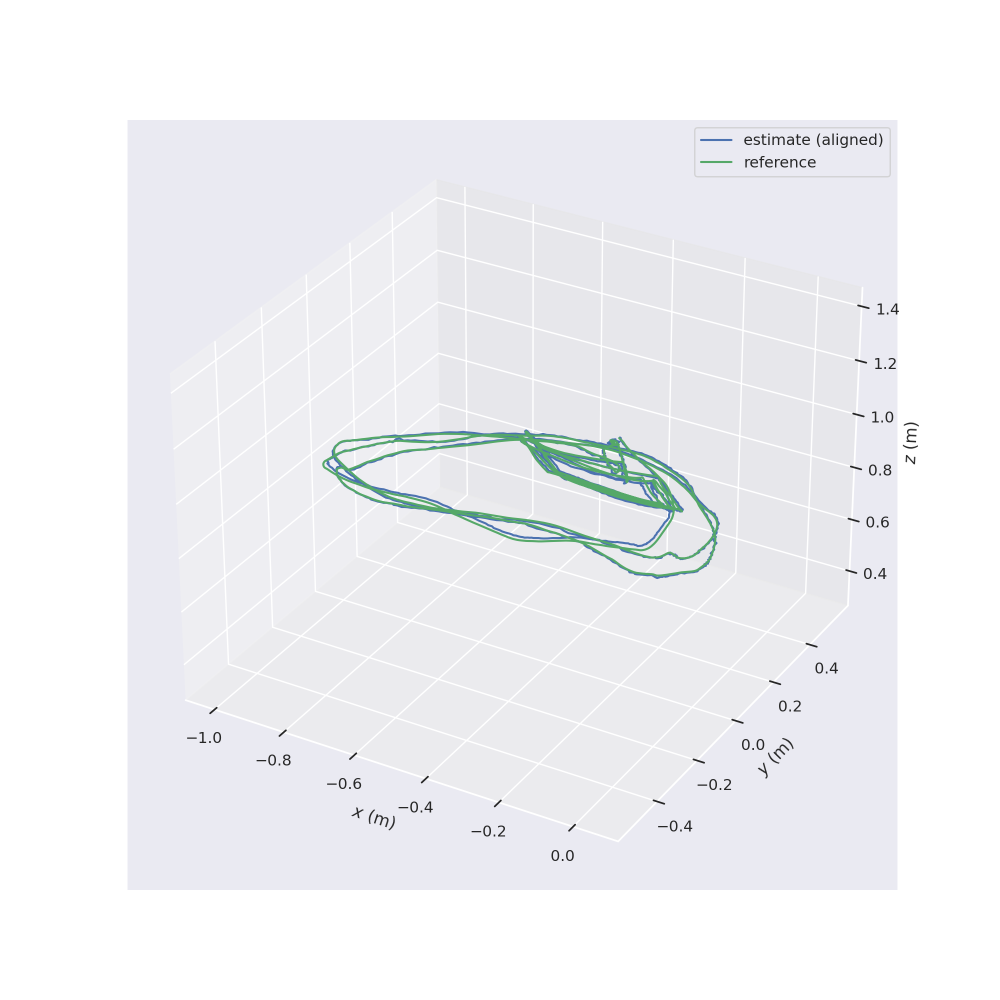

[DEBUG][2023-08-01 00:54:24,197][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 00:54:24,256][trajectory.align():214]
Rotation of alignment:
[[-0.98488647  0.1651375  -0.05223269]
 [ 0.17050267  0.87137641 -0.46003478]
 [-0.03045466 -0.46198784 -0.88636322]]
Translation of alignment:
[-0.41946102  0.35297497  0.89344546]
[DEBUG][2023-08-01 00:54:24,261][trajectory.align():216]
Scale correction: 1.2961704803842826


<IPython.core.display.Javascript object>

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A7/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A7.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>


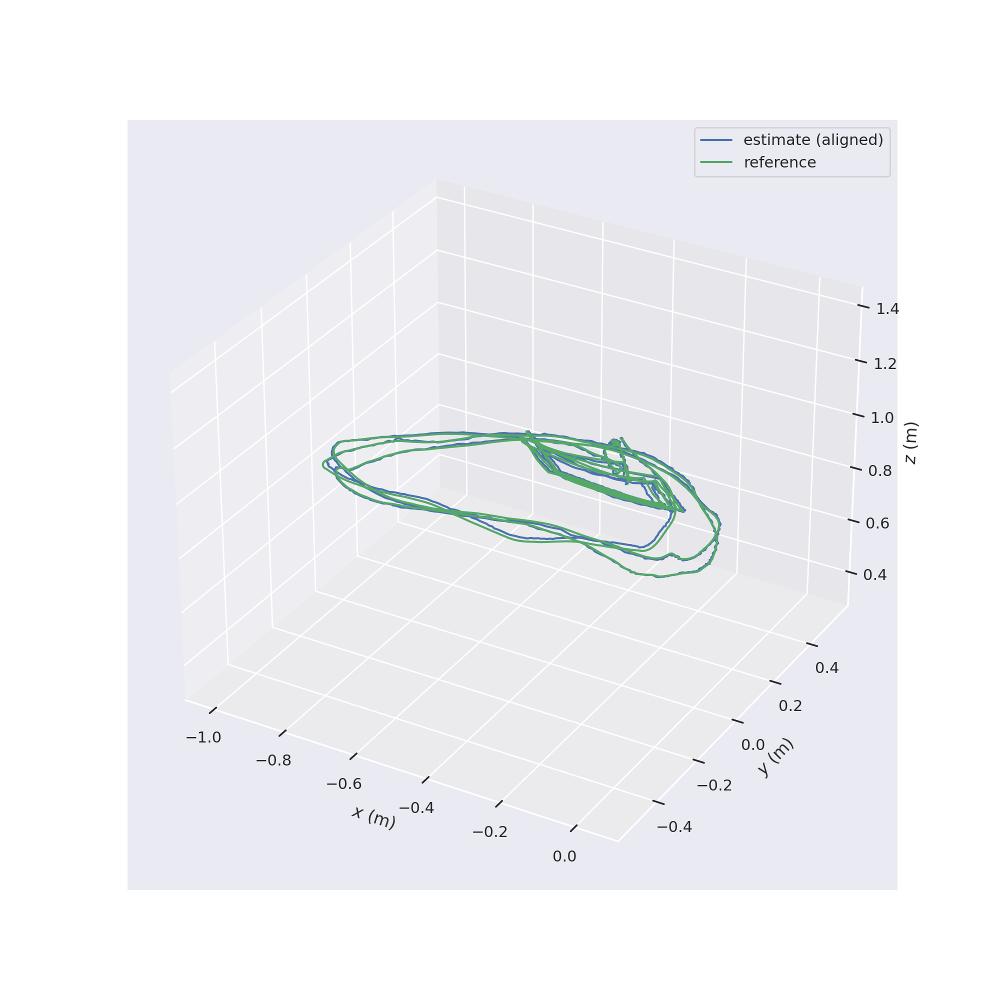

[DEBUG][2023-08-01 01:02:14,245][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 01:02:14,304][trajectory.align():214]
Rotation of alignment:
[[-0.98485103  0.16535828 -0.05220247]
 [ 0.17066697  0.87108297 -0.46052931]
 [-0.03067965 -0.462462   -0.88610815]]
Translation of alignment:
[-0.41911695  0.35309466  0.89317592]
[DEBUG][2023-08-01 01:02:14,309][trajectory.align():216]
Scale correction: 1.3180411410787625


<IPython.core.display.Javascript object>


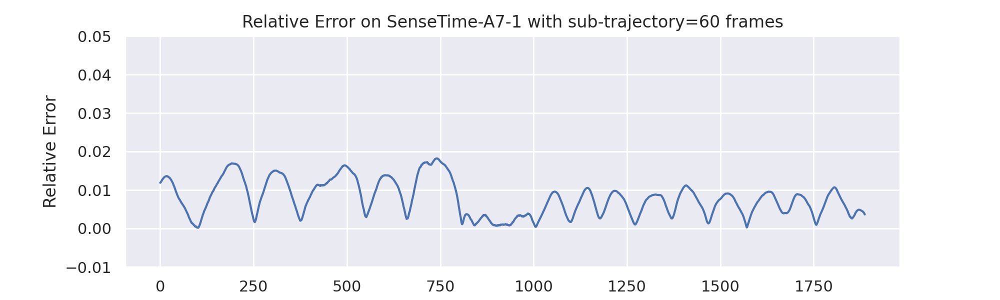

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A7/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A7.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

<IPython.core.display.Javascript object>


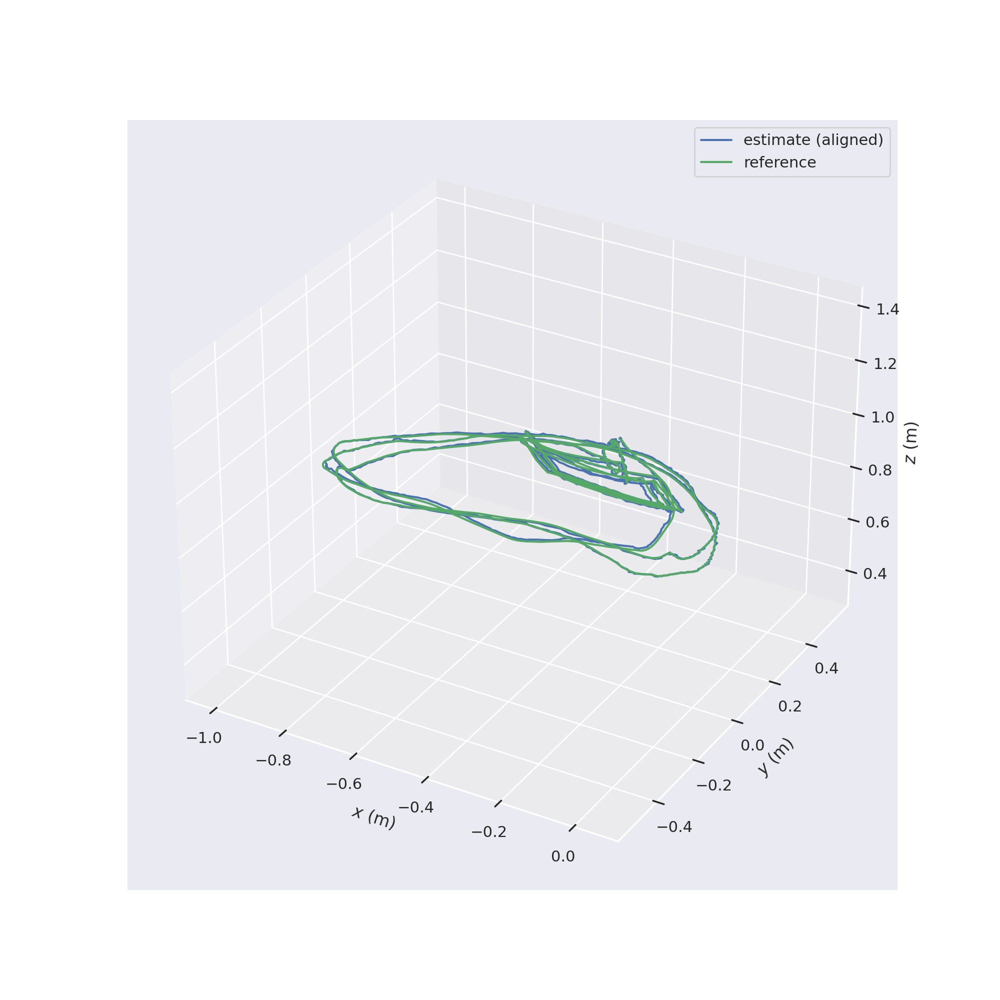

[DEBUG][2023-08-01 01:10:04,727][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 01:10:04,784][trajectory.align():214]
Rotation of alignment:
[[-0.98498042  0.16445916 -0.05259991]
 [ 0.17011756  0.87217067 -0.45867018]
 [-0.02955641 -0.46072932 -0.88704843]]
Translation of alignment:
[-0.41926755  0.35319844  0.89391254]
[DEBUG][2023-08-01 01:10:04,789][trajectory.align():216]
Scale correction: 1.314159586360799


<IPython.core.display.Javascript object>


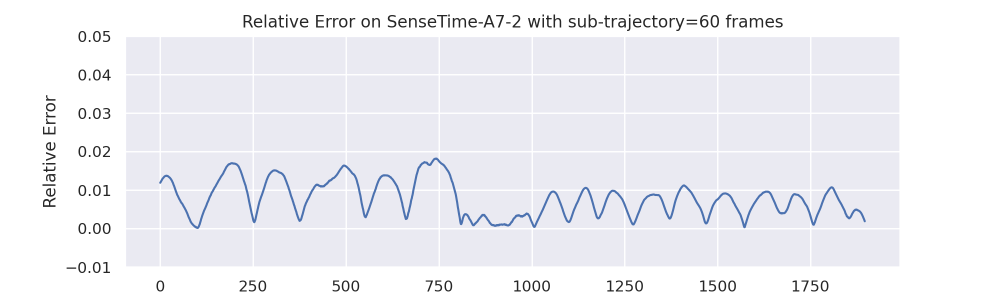

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A7/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A7.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546

Segmentation fault (core dumped)


[DEBUG][2023-08-01 01:17:52,018][file_interface.read_tum_trajectory_file():117]
Loaded 1957 stamps and poses from: ./logs/trajectory.txt
[DEBUG][2023-08-01 01:17:52,976][file_interface.read_tum_trajectory_file():117]
Loaded 30159 stamps and poses from: ./logs/ground_truth.txt
[DEBUG][2023-08-01 01:17:53,415][sync.associate_trajectories():110]
Found 1957 of max. 1957 possible matching timestamps between...
	first trajectory
and:	second trajectory
..with max. time diff.: 0.01 (s) and time offset: 0.0 (s).
[DEBUG][2023-08-01 01:17:53,422][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 01:17:53,479][trajectory.align():214]
Rotation of alignment:
[[-0.98491193  0.16497868 -0.05225436]
 [ 0.17038045  0.87152832 -0.45979222]
 [-0.03031476 -0.46175797 -0.88648778]]
Translation of alignment:
[-0.41922637  0.35306112  0.89367431]
[DEBUG][2023-08-01 01:17:53,485][trajectory.align():216]
Scale correction: 1.316588535237758
[DEBUG][2023-08-01 0

<IPython.core.display.Javascript object>


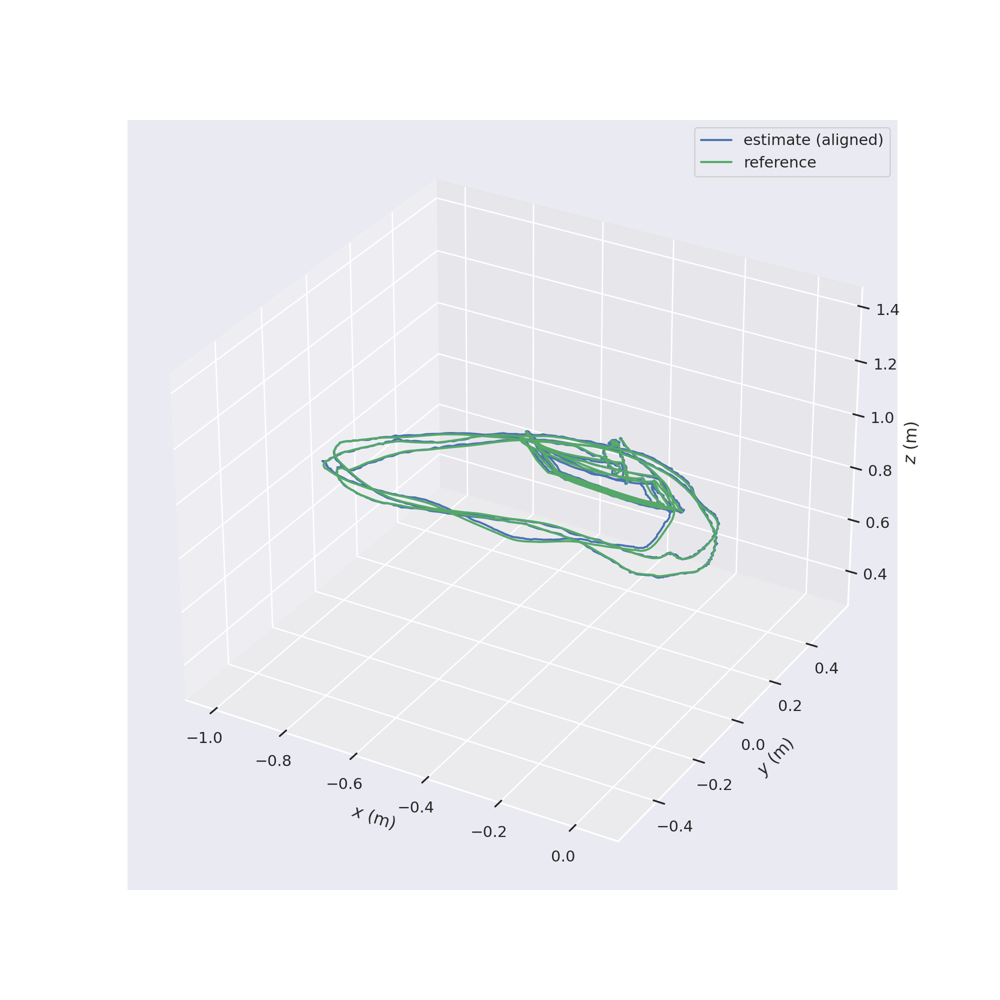

[DEBUG][2023-08-01 01:17:54,316][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 01:17:54,379][trajectory.align():214]
Rotation of alignment:
[[-0.98491193  0.16497868 -0.05225436]
 [ 0.17038045  0.87152832 -0.45979222]
 [-0.03031476 -0.46175797 -0.88648778]]
Translation of alignment:
[-0.41922637  0.35306112  0.89367431]
[DEBUG][2023-08-01 01:17:54,384][trajectory.align():216]
Scale correction: 1.316588535237758


<IPython.core.display.Javascript object>


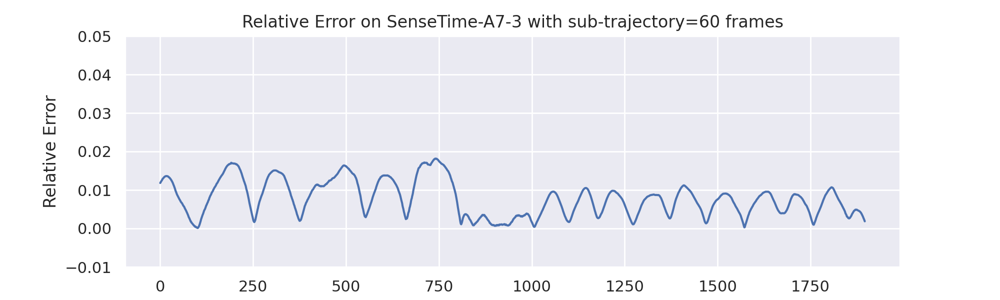

./Examples/Monocular/mono_tum_vi ./Vocabulary/ORBvoc.txt ./Examples/Monocular/SenseTime.yaml ./datasets/SenseTime/A7/camera/images/ ./Examples/Monocular/SenseTime_TimeStamps/A7.txt
num_seq = 1
Loading images for sequence 0...LOADED!

-------

ORB-SLAM3 Copyright (C) 2017-2020 Carlos Campos, Richard Elvira, Juan J. Gómez, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
ORB-SLAM2 Copyright (C) 2014-2016 Raúl Mur-Artal, José M.M. Montiel and Juan D. Tardós, University of Zaragoza.
This program comes with ABSOLUTELY NO WARRANTY;
This is free software, and you are welcome to redistribute it
under certain conditions. See LICENSE.txt.

Input sensor was set to: Monocular

Loading ORB Vocabulary. This could take a while...
Vocabulary loaded!

Initialization of Atlas from scratch 
Creation of new map with id: 0
Creation of new map with last KF id: 0
Seq. Name: 

Camera Parameters: 
- Camera: Pinhole
- Image scale: 1
- fx: 493.01669311523438
- fy: 491.55953979492188
- cx: 317.978546


(mono_tum_vi:41142): Gtk-CRITICAL **: 01:25:37.851: IA__gtk_window_get_size: assertion 'GTK_IS_WINDOW (window)' failed

(mono_tum_vi:41142): Gtk-CRITICAL **: 01:25:37.852: IA__gtk_widget_get_screen: assertion 'GTK_IS_WIDGET (widget)' failed
Bus error (core dumped)


[DEBUG][2023-08-01 01:25:42,980][file_interface.read_tum_trajectory_file():117]
Loaded 1957 stamps and poses from: ./logs/trajectory.txt
[DEBUG][2023-08-01 01:25:43,934][file_interface.read_tum_trajectory_file():117]
Loaded 30159 stamps and poses from: ./logs/ground_truth.txt
[DEBUG][2023-08-01 01:25:44,360][sync.associate_trajectories():110]
Found 1957 of max. 1957 possible matching timestamps between...
	first trajectory
and:	second trajectory
..with max. time diff.: 0.01 (s) and time offset: 0.0 (s).
[DEBUG][2023-08-01 01:25:44,365][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 01:25:44,419][trajectory.align():214]
Rotation of alignment:
[[-0.98500081  0.16404553 -0.05350204]
 [ 0.17014564  0.87182873 -0.4593094 ]
 [-0.02870304 -0.46152327 -0.88666364]]
Translation of alignment:
[-0.41931193  0.35306538  0.893315  ]
[DEBUG][2023-08-01 01:25:44,425][trajectory.align():216]
Scale correction: 1.310962317838003
[DEBUG][2023-08-01 0

<IPython.core.display.Javascript object>


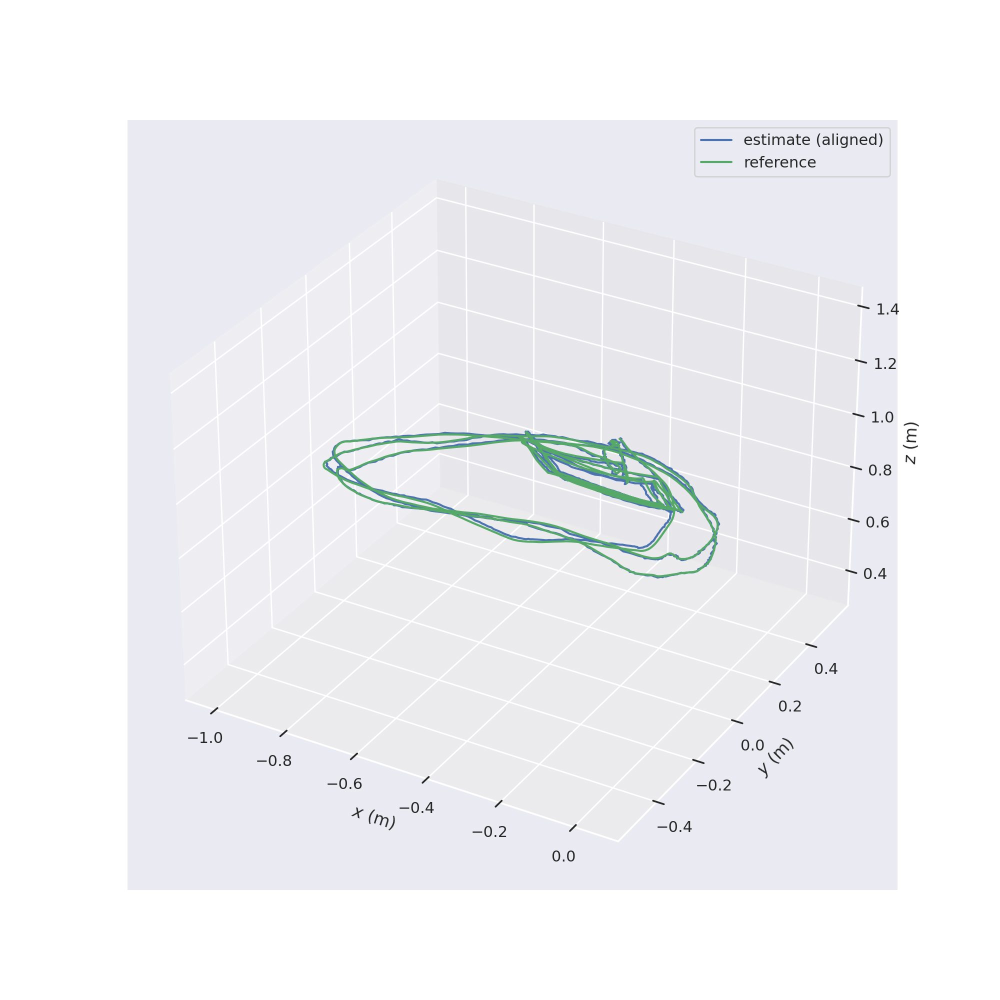

[DEBUG][2023-08-01 01:25:45,263][trajectory.align():202]
Aligning using Umeyama's method... (with scale correction)
[DEBUG][2023-08-01 01:25:45,325][trajectory.align():214]
Rotation of alignment:
[[-0.98500081  0.16404553 -0.05350204]
 [ 0.17014564  0.87182873 -0.4593094 ]
 [-0.02870304 -0.46152327 -0.88666364]]
Translation of alignment:
[-0.41931193  0.35306538  0.893315  ]
[DEBUG][2023-08-01 01:25:45,329][trajectory.align():216]
Scale correction: 1.310962317838003


<IPython.core.display.Javascript object>

In [22]:
delete_files_in_folder("./logs")
delete_files_in_folder("./data")
delete_files_in_folder("./figures")

trials = 5

for scriptDict in SLAMScripts:    
    time.sleep(1)
    
    for trial in range(0, trials):
        print(scriptDict['script'])
        os.system(scriptDict['script'])
        time.sleep(1)

        df, df_traj, initial_rows = read_log()
        time.sleep(1)

        copy_gtruth(scriptDict)
        time.sleep(1)

        delta = 60
        traj_est, traj_ref, error = calculate_RE(delta)

        benchmark = scriptDict["benchmark"]
        trajectory = scriptDict["trajectory"]

        plot_aligned_trajectory(traj_est, traj_ref, benchmark, trajectory, trial)

        plot_error(error, delta, benchmark, trajectory, trial)

        df_data = attach_label_2_features(delta, error, df)
        time.sleep(1)

        df_data.to_csv("./data/{}_{}_{}.csv".format(benchmark,trajectory, trial), sep=' ', index=False, header=True)
        time.sleep(20)